In [1]:
import os
import scipy.io as spi
import visual as vi
import numpy as np
from utils import *
from stats import plot_forward_search
import seaborn as sns
from itertools import chain
import cv2
from time import time

In [2]:
directory = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelFM'

# List all files in the directory
files = os.listdir(directory)

# Filter out only the .mat files
mat_files = [file for file in files if file.endswith('.mat')]

# Load each .mat file
mat_data = {}
names=[]
for file in mat_files:
    file_path = os.path.join(directory, file)
    names.append(file)
    mat_data[file] = spi.loadmat(file_path)

53.0 inliers found
[74.]


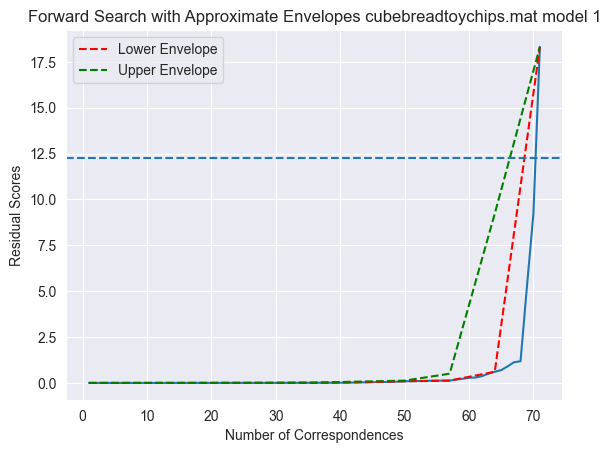

38.0 inliers found
[77.]


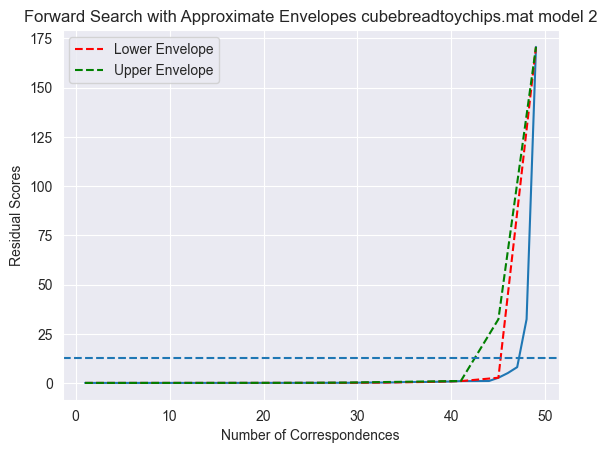

25.0 inliers found
[65.]


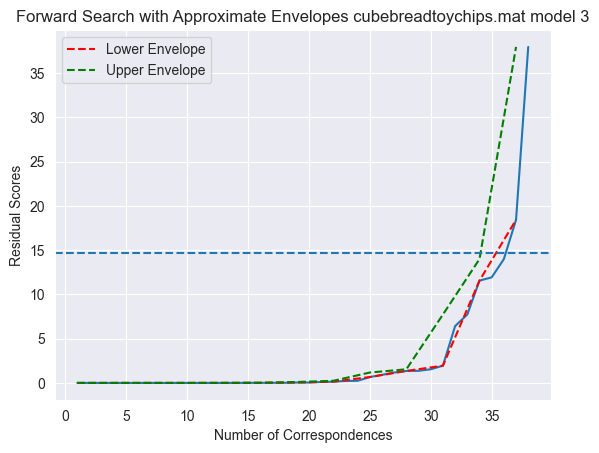

73.0 inliers found
[90.]


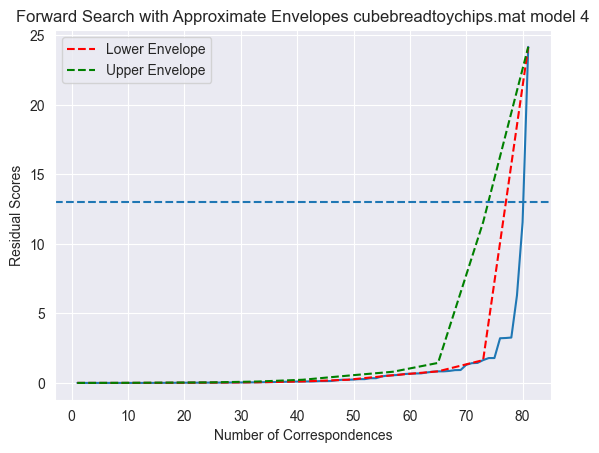

66.0 inliers found
[84.]


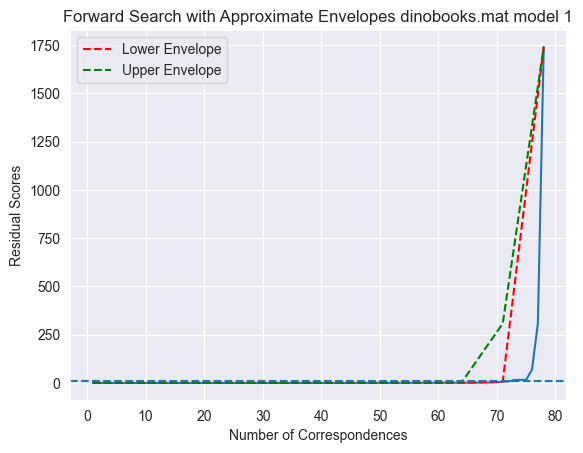

70.0 inliers found
[81.]


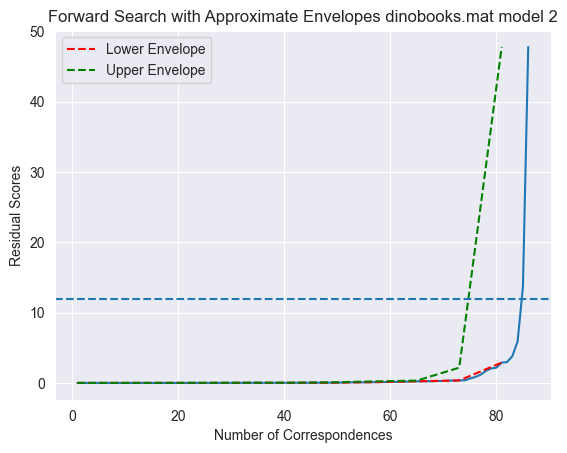

34.0 inliers found
[82.]


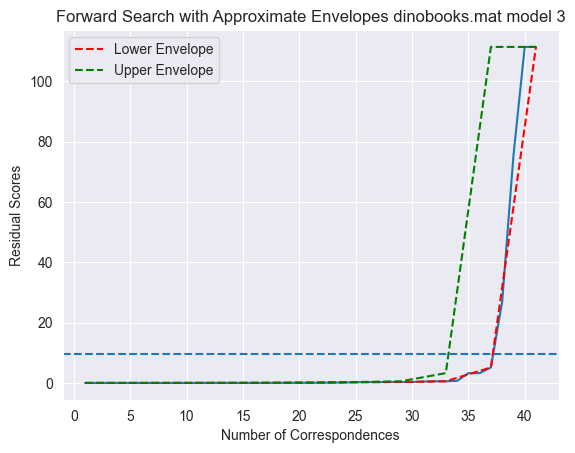

135.0 inliers found
[92.]


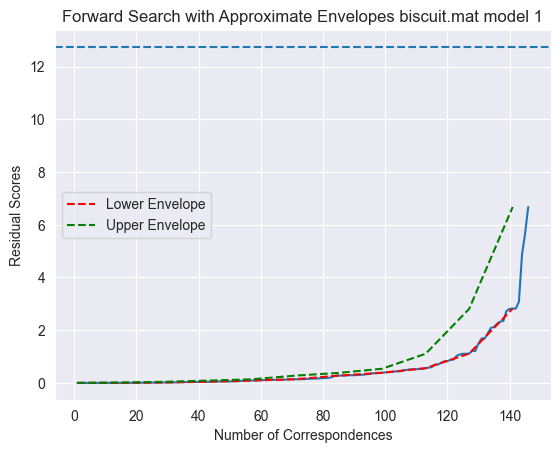

58.0 inliers found
[92.]


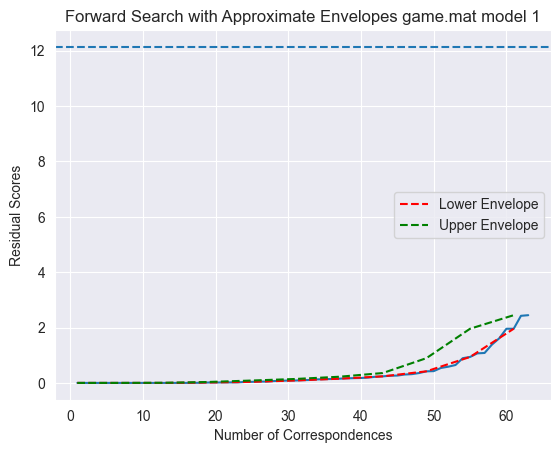

83.0 inliers found
[85.]


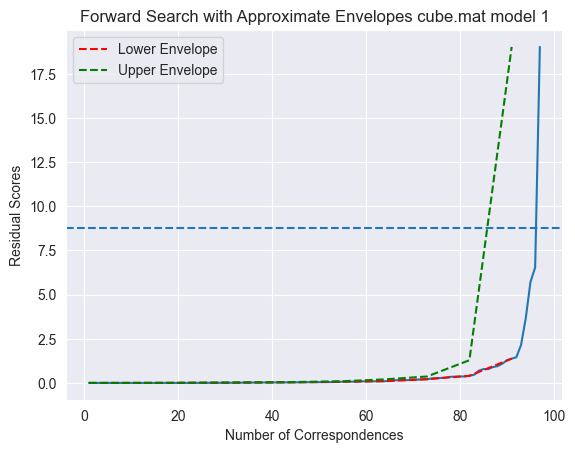

87.0 inliers found
[82.]


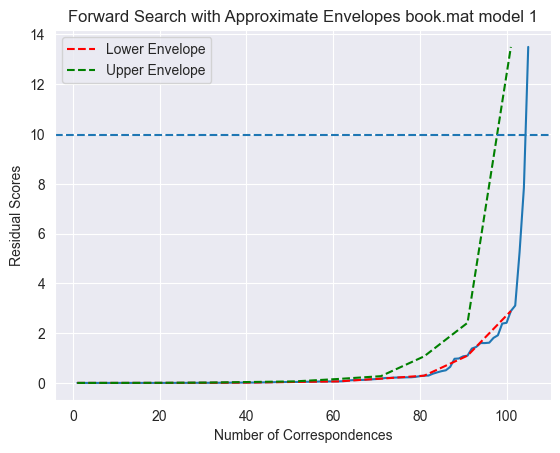

25.0 inliers found
[67.]


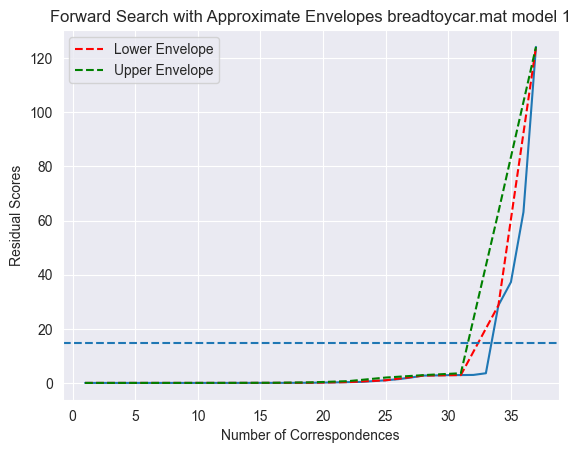

33.0 inliers found
[84.]


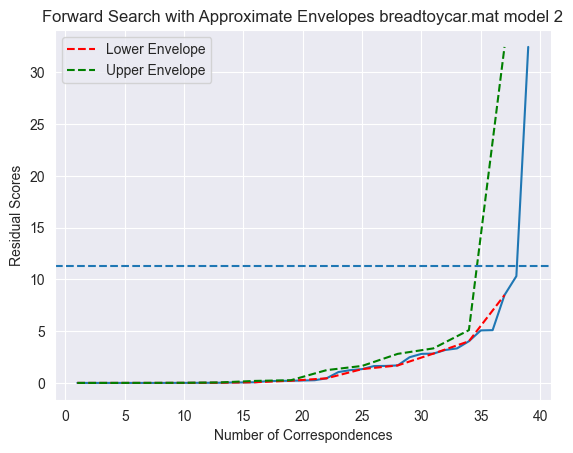

23.0 inliers found
[67.]


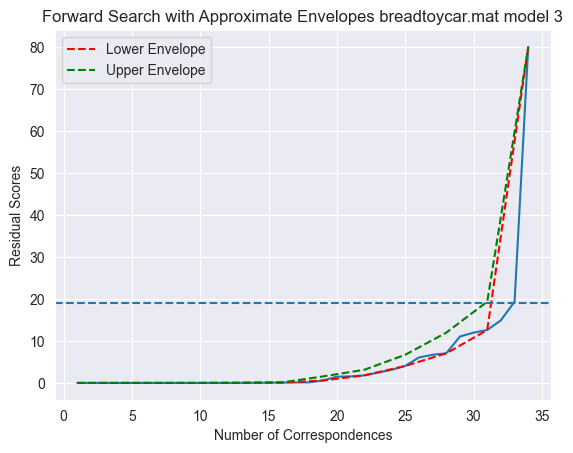

62.0 inliers found
[84.]


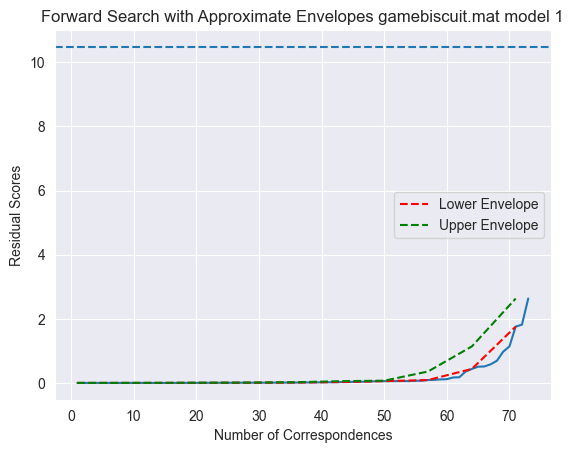

67.0 inliers found
[76.]


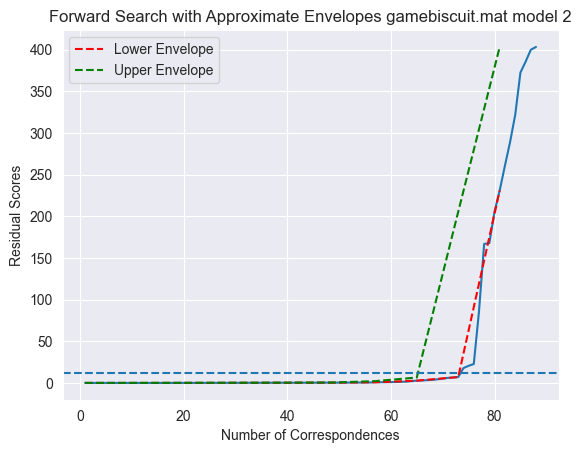

34.0 inliers found
[75.]


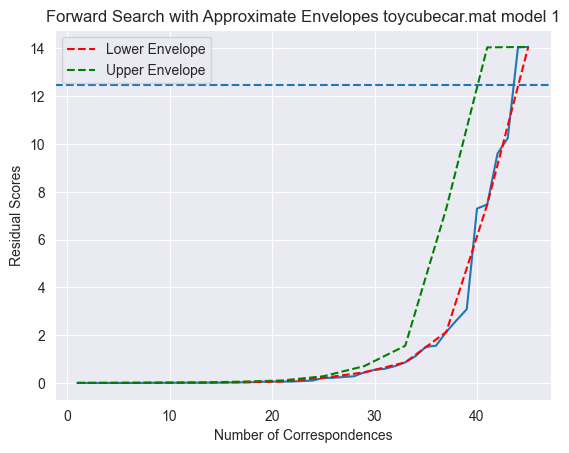

63.0 inliers found
[91.]


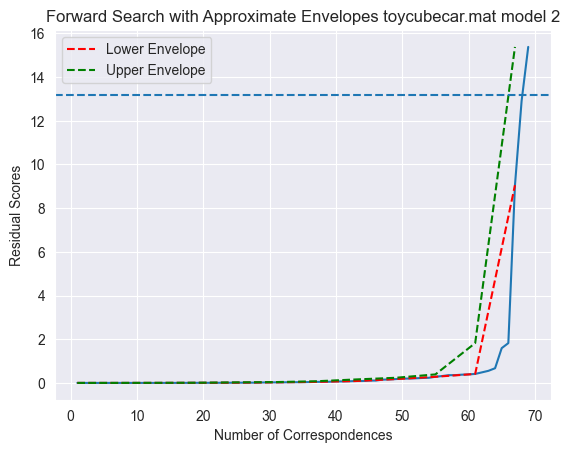

8.0 inliers found
[57.]


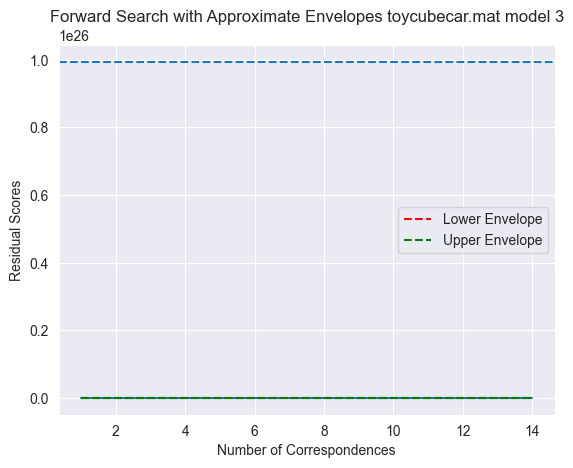

55.0 inliers found
[82.]


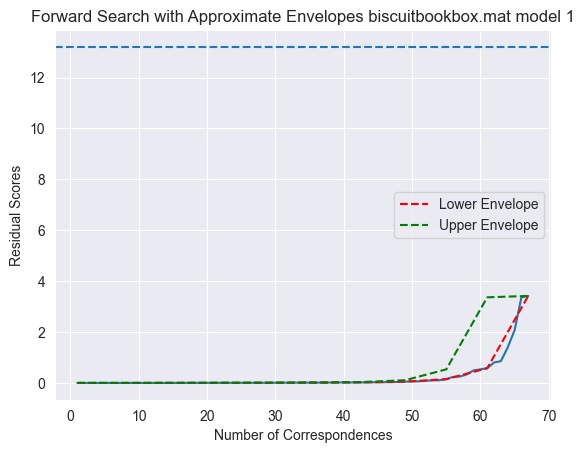

36.0 inliers found
[87.]


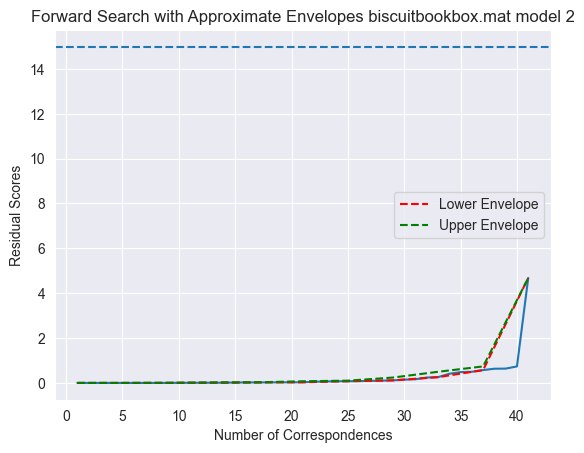

47.0 inliers found
[87.]


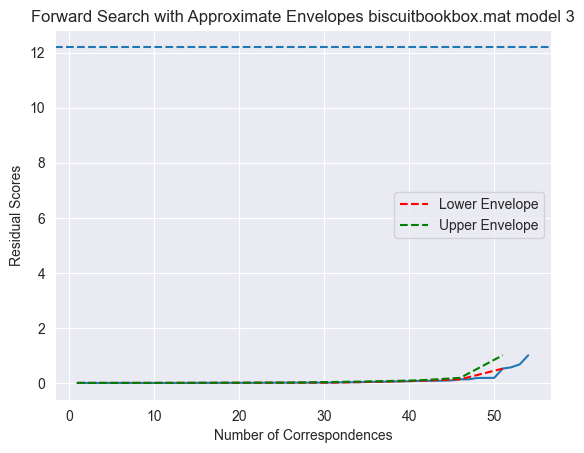

27.0 inliers found
[79.]


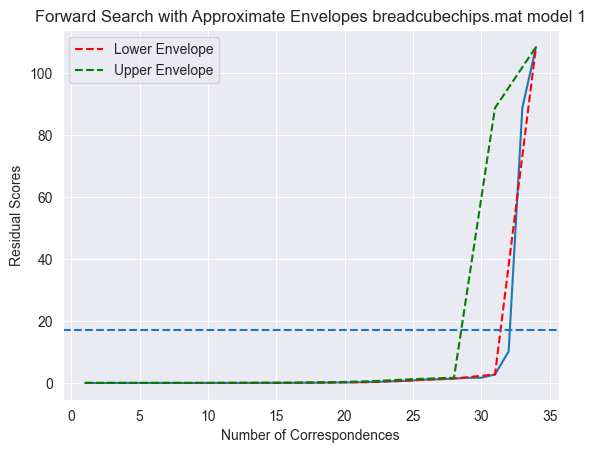

54.0 inliers found
[94.]


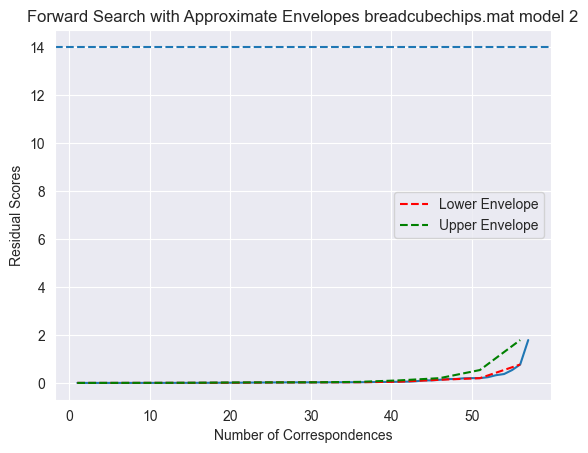

49.0 inliers found
[84.]


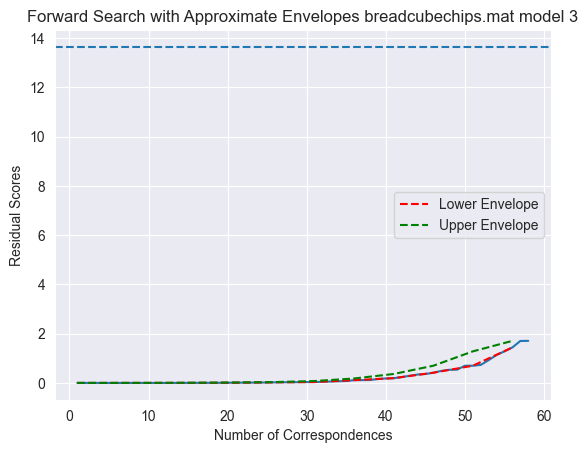

25.0 inliers found
[75.]


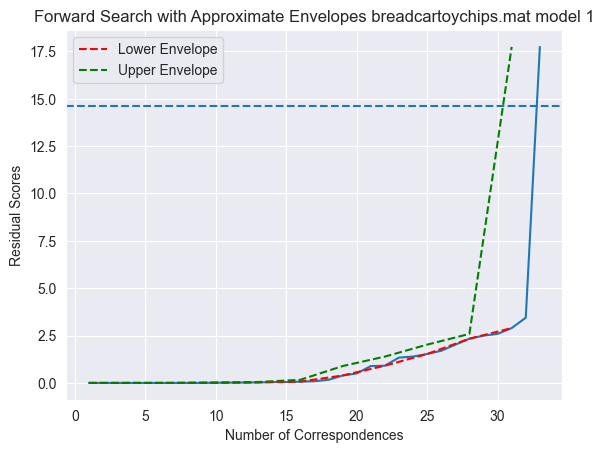

16.0 inliers found
[69.]


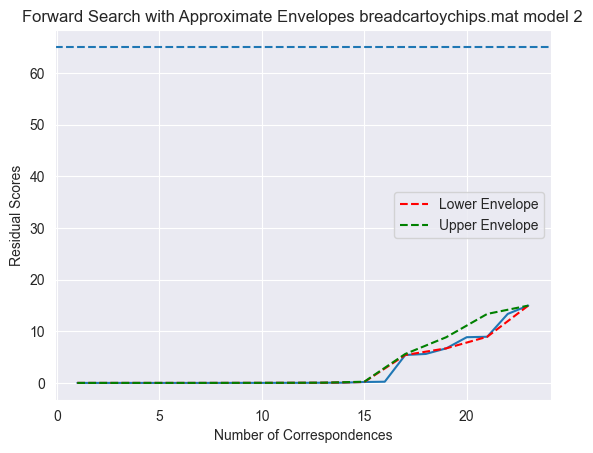

31.0 inliers found
[75.]


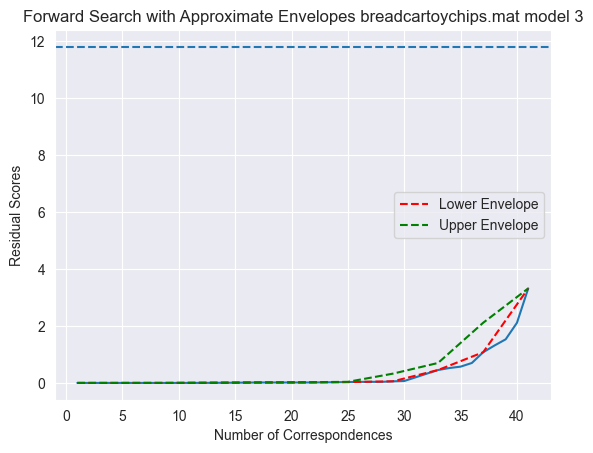

52.0 inliers found
[89.]


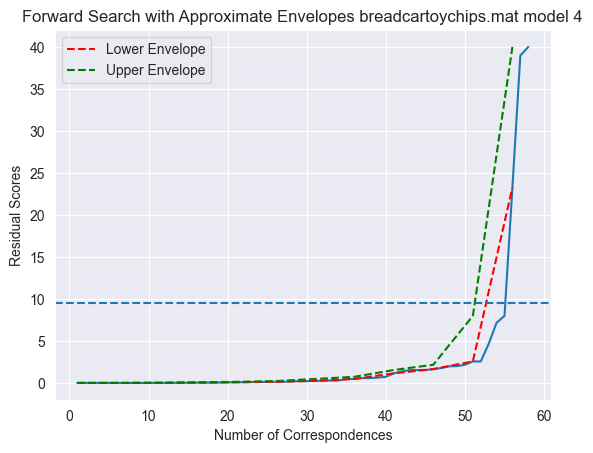

87.0 inliers found
[89.]


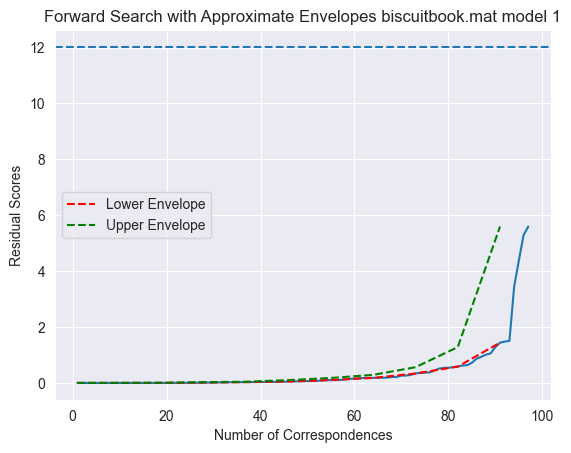

70.0 inliers found
[85.]


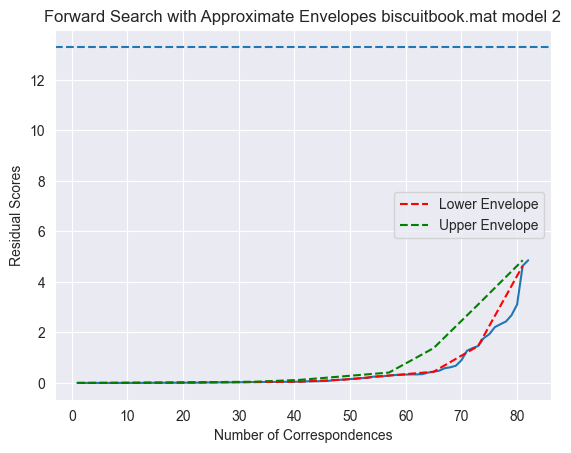

57.0 inliers found
[82.]


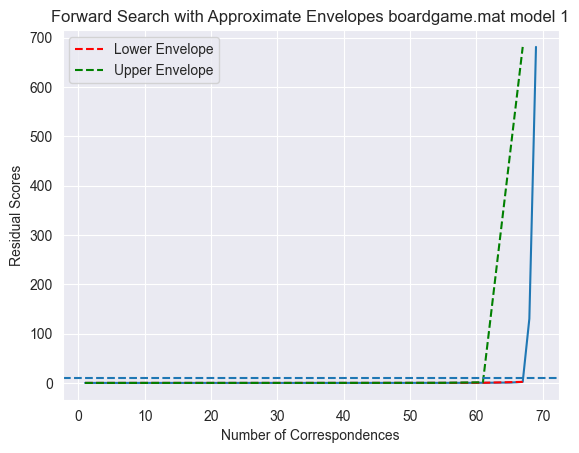

61.0 inliers found
[89.]


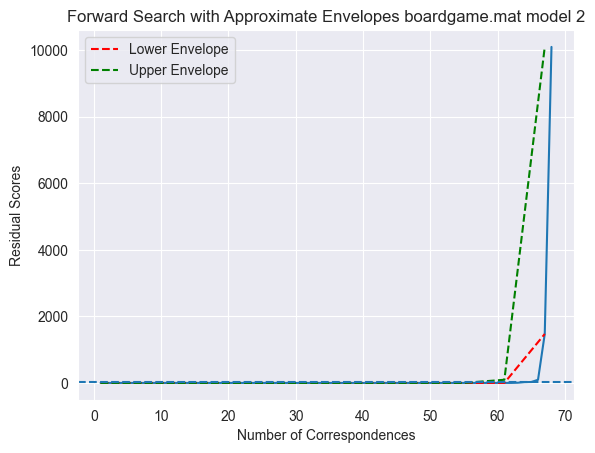

21.0 inliers found
[72.]


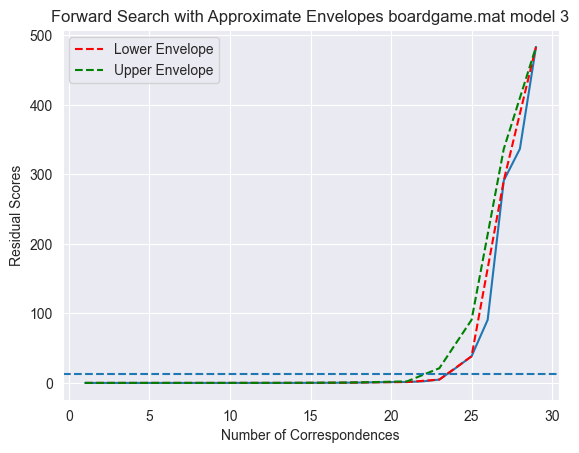

74.0 inliers found
[88.]


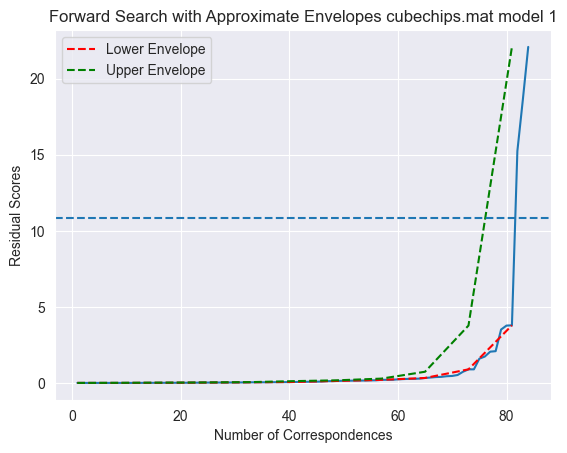

48.0 inliers found
[84.]


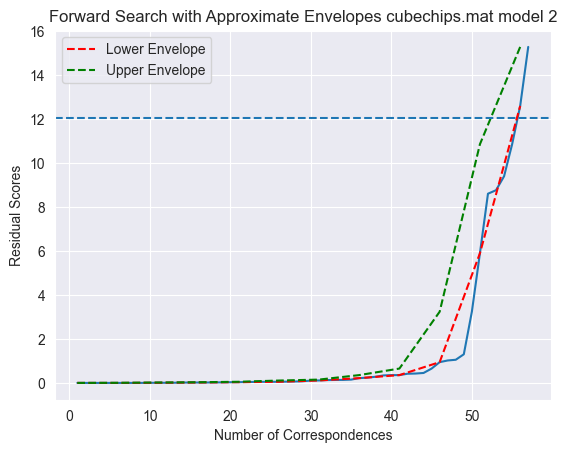

10.0 inliers found
[52.]


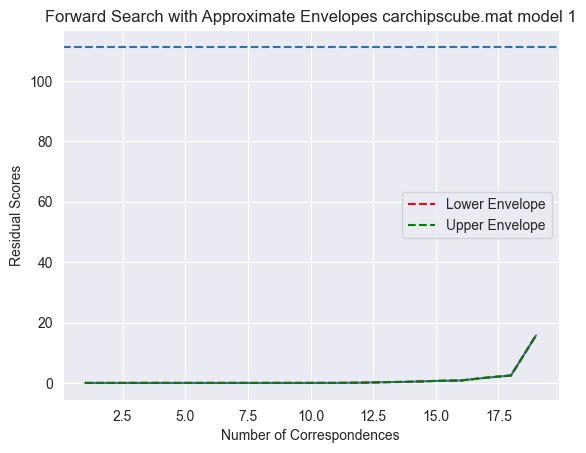

26.0 inliers found
[78.]


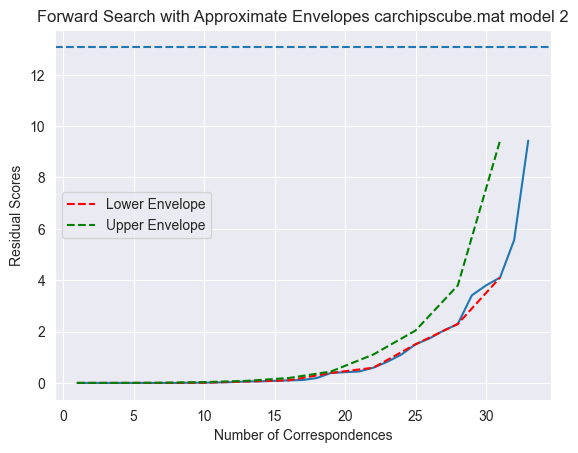

43.0 inliers found
[81.]


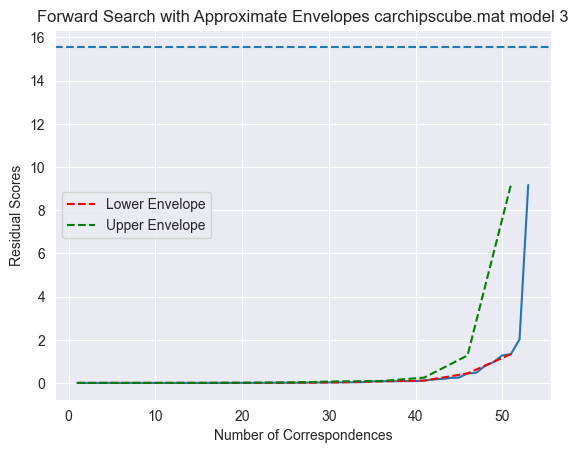

69.0 inliers found
[88.]


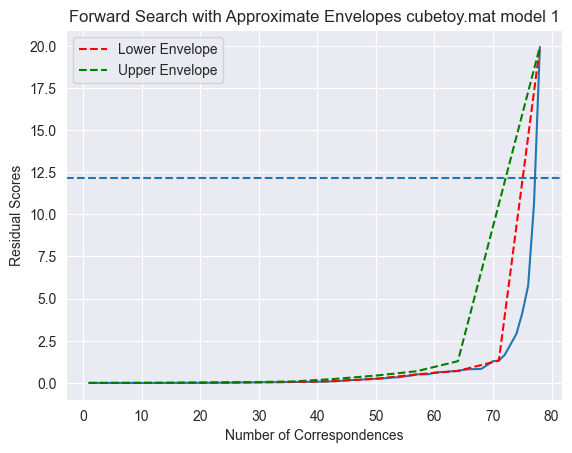

60.0 inliers found
[83.]


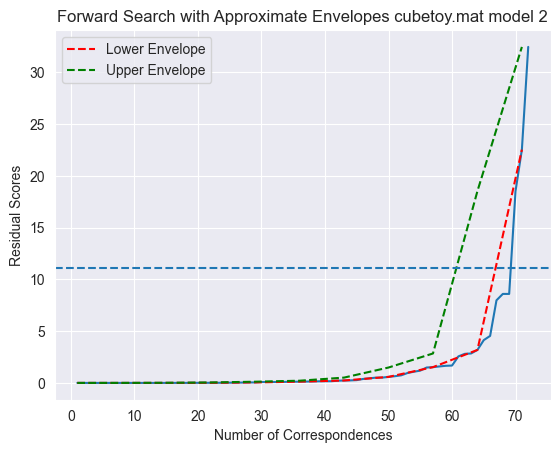

56.0 inliers found
[88.]


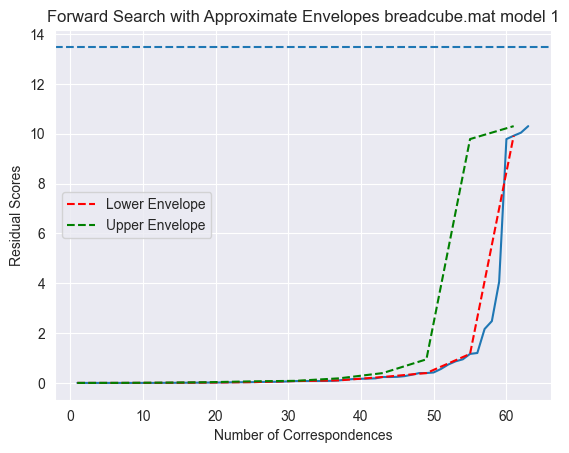

90.0 inliers found
[88.]


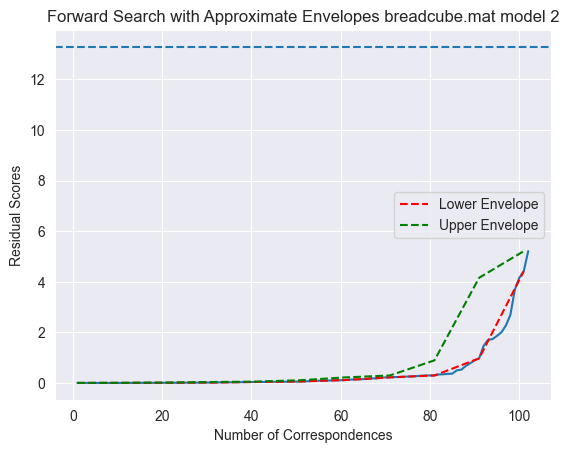

115.0 inliers found
[92.]


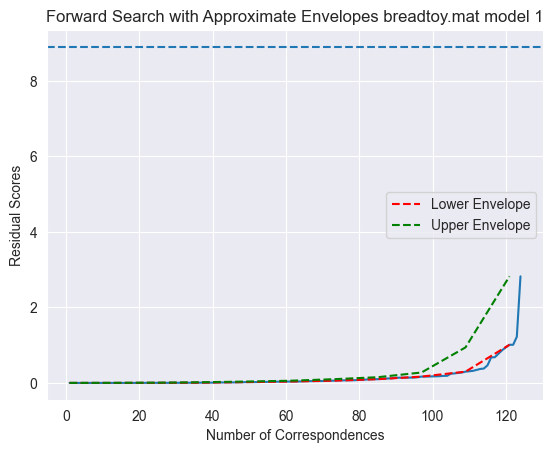

52.0 inliers found
[89.]


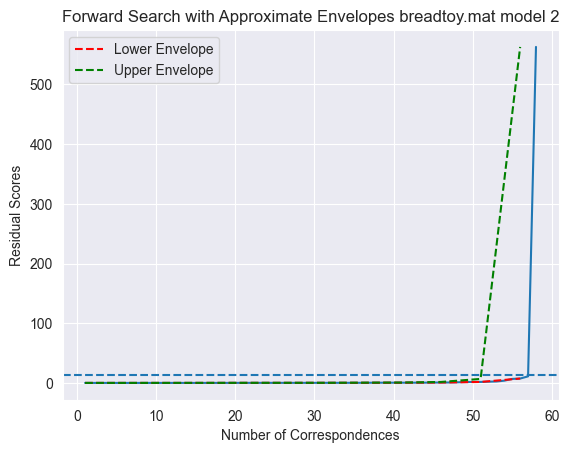

In [3]:
number_of_data_to_analyse=len(names)
thresholds = [[] for i in range(number_of_data_to_analyse)]

for i in range(number_of_data_to_analyse):

    data = mat_data[names[i]]

    outliers, models = vi.group_models(data)["outliers"], vi.group_models(data)["models"]

    points = extract_points(models, data)

    for l in np.unique(points[3]):

        src_points = points[1][np.where(points[3] == l)]

        dst_points = points[2][np.where(points[3] == l)]

        thresholds[i].append(plot_forward_search(src_points, dst_points, title=names[i] + " model " + str(l), type='FM'))

In [4]:
thresholds = [list(chain.from_iterable(thresholds[i])) for i in range(len(thresholds))]

In [15]:
list(chain.from_iterable(thresholds))

[12.262685659215919,
 12.710945687028637,
 14.684340130683813,
 13.006353110062067,
 9.364029082066619,
 11.98787454779024,
 9.429957302579668,
 12.745139948997451,
 12.136779604718019,
 8.786563594083173,
 9.975296811974404,
 14.720237661189646,
 11.29738316616859,
 19.022430956191794,
 10.482607865714597,
 11.810134723526643,
 12.477201389383694,
 13.162365438569378,
 9.934685349176633e+25,
 13.205098638423996,
 14.98080548384324,
 12.204484151732906,
 17.072160174065107,
 13.995992323148725,
 13.635429363737403,
 14.636275817313978,
 65.05624600014113,
 11.802384474095824,
 9.527697456585889,
 12.02168615649738,
 13.304198943161879,
 9.618191032545461,
 12.817110892134487,
 13.044952448928852,
 10.840484157343377,
 12.044053965206173,
 111.2386878945334,
 13.085220528529916,
 15.561264976238956,
 12.169102233071413,
 11.050288403781217,
 13.48211507485118,
 13.287899882778081,
 8.898814166385737,
 12.55594339116442]

ValueError: Maximum allowed size exceeded

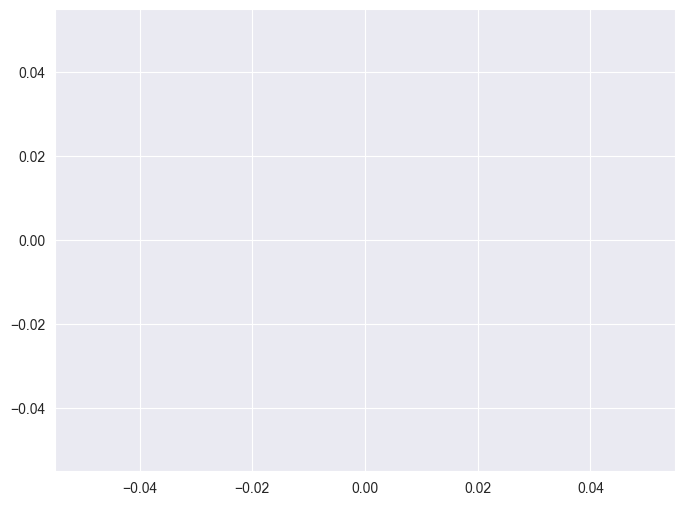

In [17]:
# Create a histogram to visualize the distribution
plt.figure(figsize=(8, 6))
sns.histplot(list(chain.from_iterable(thresholds)), bins='auto', kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
plt.xlabel("Inlier thresholds")
plt.ylabel("Density")
plt.title("Distribution of Inlier Thresholds")

plt.grid(True)
plt.xlim(0,  max(max(thresholds)))  # Set limits for silhouette scores (typically between -1 and 1)

# Display the plot
plt.show()

In [18]:
errors = []
average_error = {}
for i in range(len(names)):
    data = mat_data[names[i]]
    res = compute_inliers_residual_curve(data)

    threshold = thresholds[i]
    average_errors = analyze_reprojection_error(data, threshold, method="ransac")
    print("Average reprojection errors for inliers:")
    for threshold, error in average_errors.items():
        print(f"Threshold: {threshold}, Average Reprojection Error: {error:.4f}")
        errors.append(error)

71.0 inliers found
45.0 inliers found
34.0 inliers found
81.0 inliers found
Average reprojection errors for inliers:
Threshold: 12.262685659215919, Average Reprojection Error: 2.9854
Threshold: 12.710945687028637, Average Reprojection Error: 3.0772
Threshold: 14.684340130683813, Average Reprojection Error: 2.6597
Threshold: 13.006353110062067, Average Reprojection Error: 3.0400
46.0 inliers found
78.0 inliers found
32.0 inliers found
Average reprojection errors for inliers:
Threshold: 9.364029082066619, Average Reprojection Error: 2.6228
Threshold: 11.98787454779024, Average Reprojection Error: 1.7882
Threshold: 9.429957302579668, Average Reprojection Error: 1.2505
97.0 inliers found
Average reprojection errors for inliers:
Threshold: 12.745139948997451, Average Reprojection Error: 3.1005
52.0 inliers found
Average reprojection errors for inliers:
Threshold: 12.136779604718019, Average Reprojection Error: 3.2907
76.0 inliers found
Average reprojection errors for inliers:
Threshold: 8.7

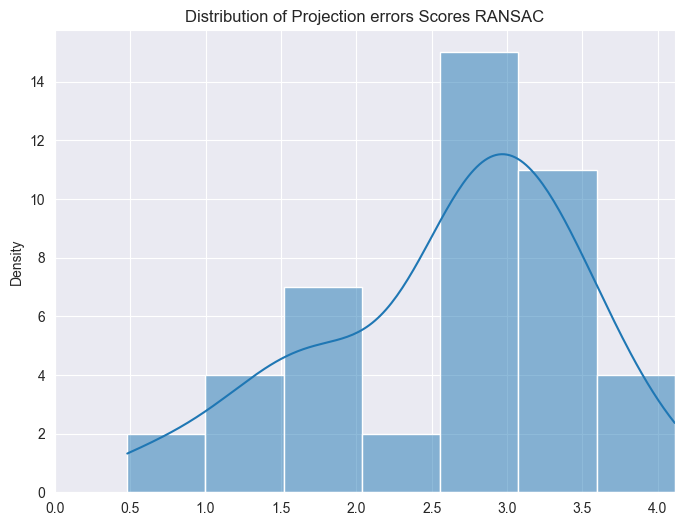

In [19]:
plt.figure(figsize=(8, 6))
sns.histplot(errors, bins='auto',
             kde=True)  # kde=True plots a kernel density estimate along with the histogram

# Label the axes and add a title
# plt.xlabel("Projection Error Average")
plt.ylabel("Density")
plt.title("Distribution of Projection errors Scores RANSAC")

plt.grid(True)
plt.xlim(0, max(errors))

# Display the plot
plt.show()

70.0 inliers found
the total number of point is:  71
The indexes of outlier points are: [157]


<Figure size 640x480 with 0 Axes>

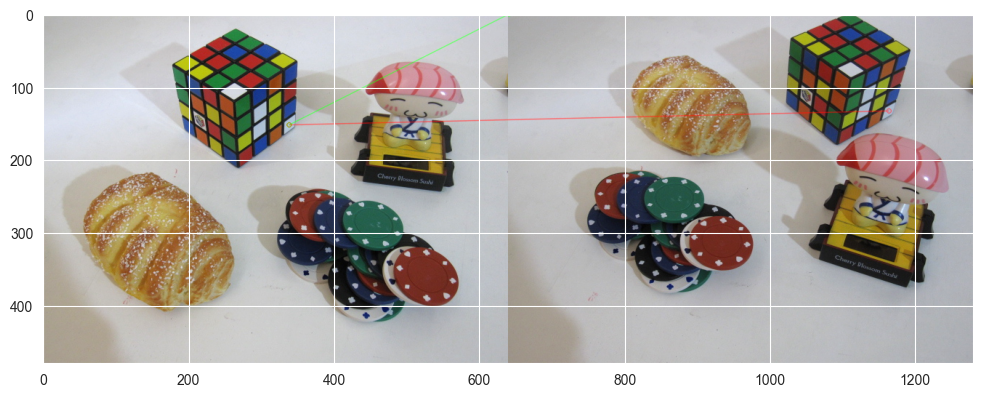

48.0 inliers found
the total number of point is:  49
The indexes of outlier points are: [205]


<Figure size 640x480 with 0 Axes>

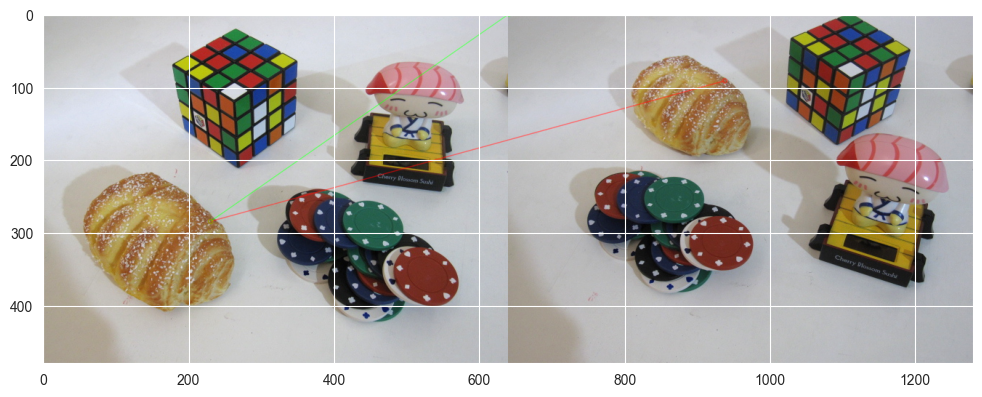

38.0 inliers found
the total number of point is:  38
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

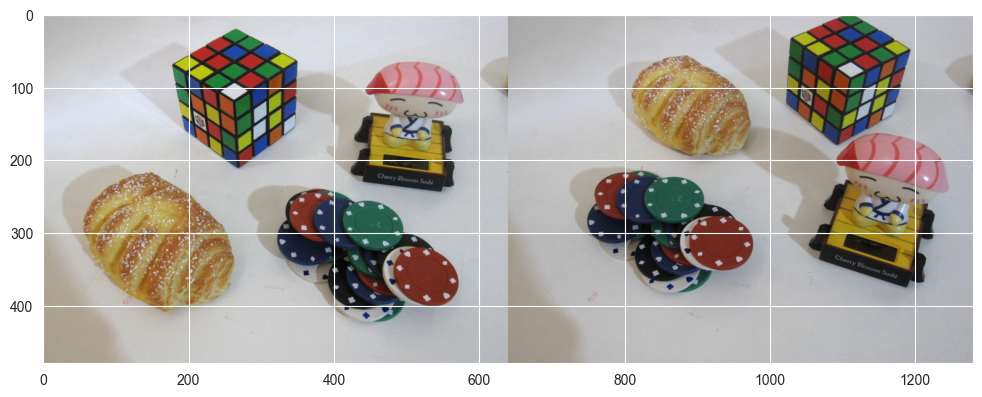

81.0 inliers found
the total number of point is:  81
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

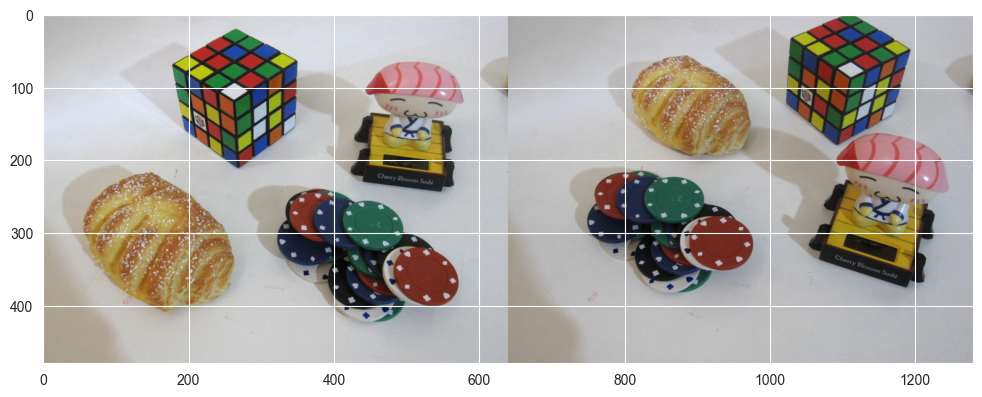

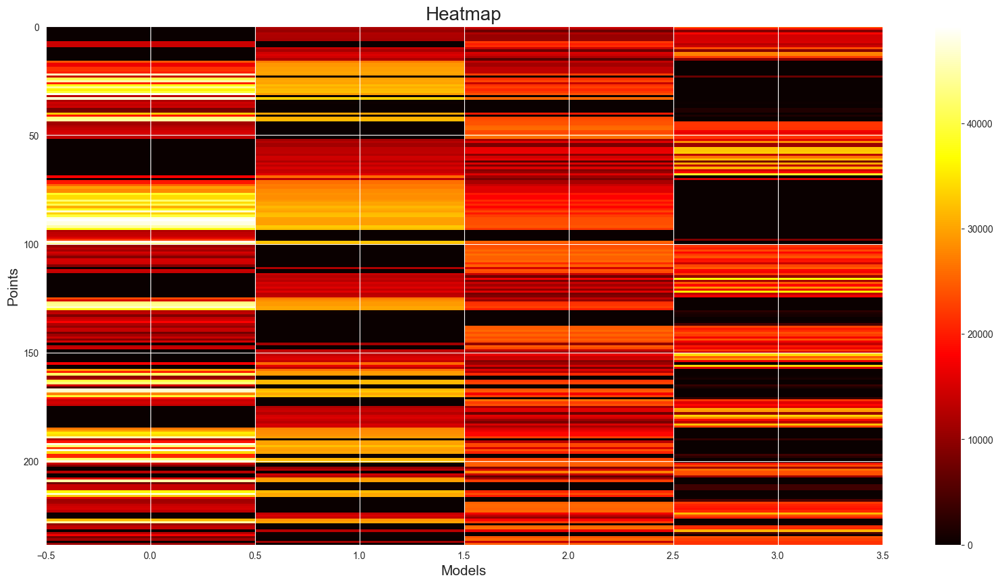

77.0 inliers found
the total number of point is:  78
The indexes of outlier points are: [184]


<Figure size 640x480 with 0 Axes>

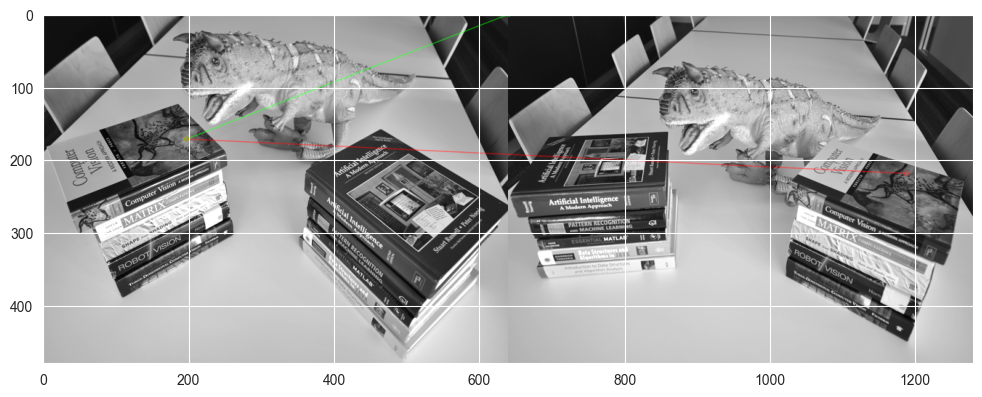

86.0 inliers found
the total number of point is:  86
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

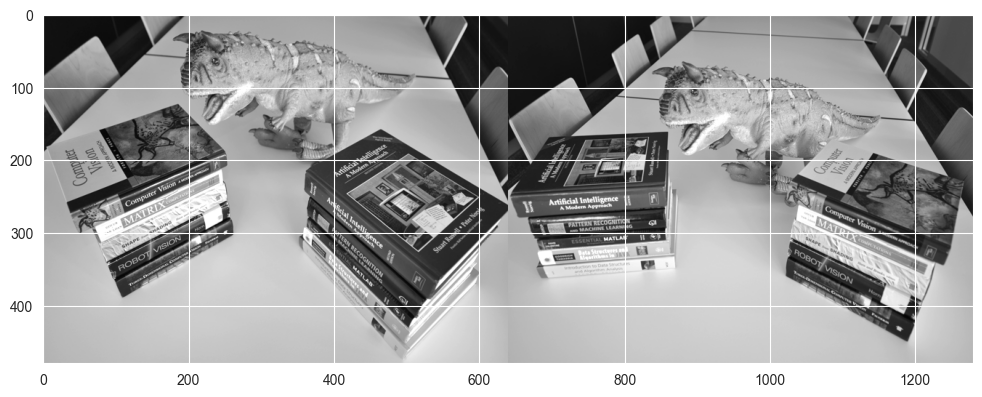

37.0 inliers found
the total number of point is:  41
The indexes of outlier points are: [49, 160, 172, 204]


<Figure size 640x480 with 0 Axes>

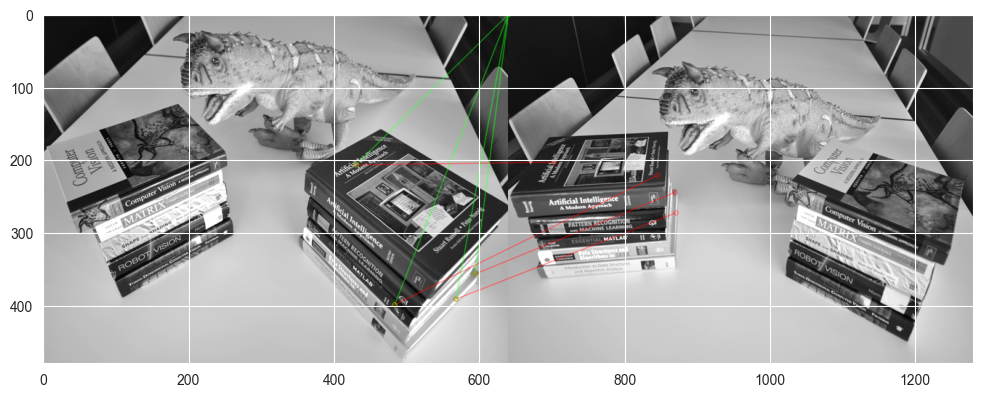

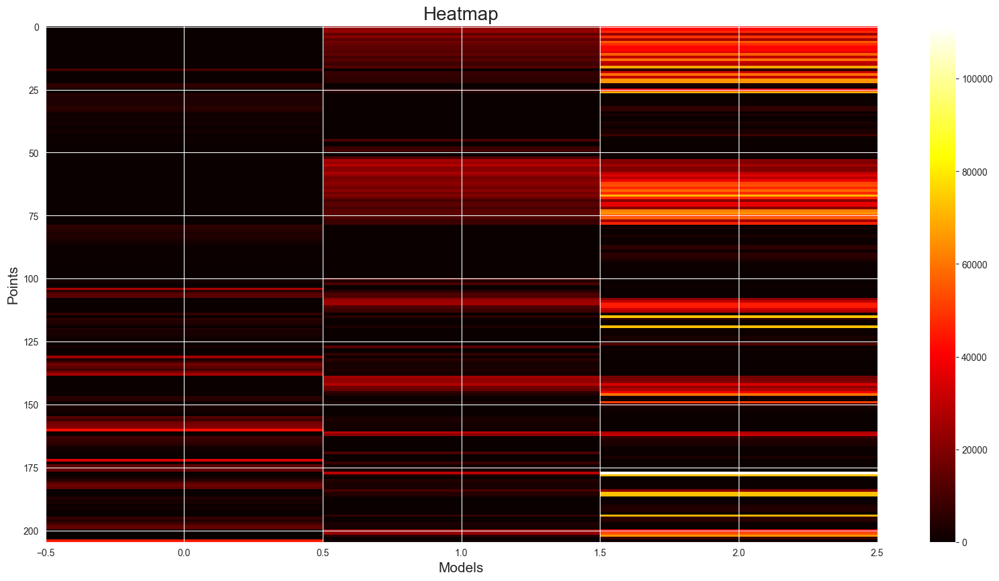

144.0 inliers found
the total number of point is:  146
The indexes of outlier points are: [0, 96]


<Figure size 640x480 with 0 Axes>

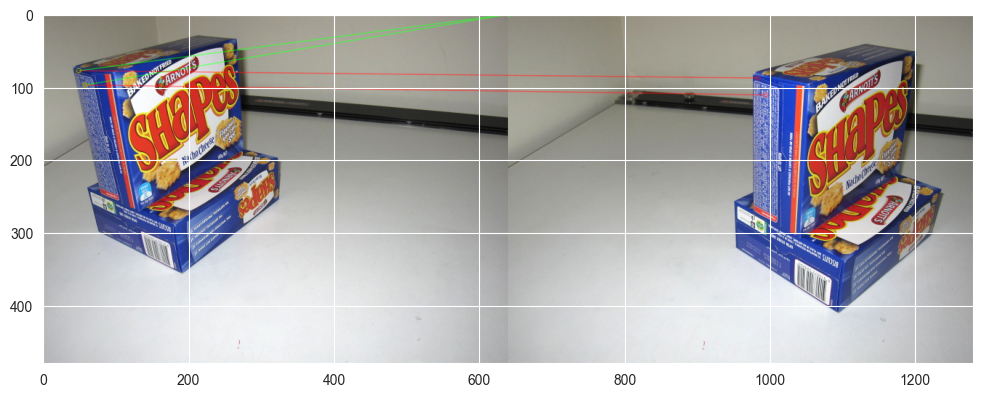

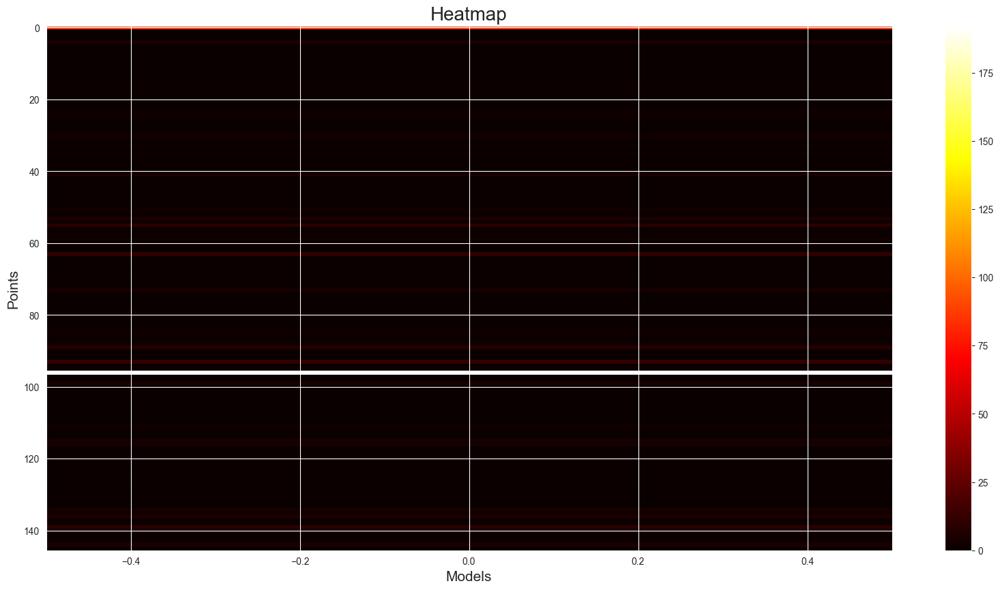

63.0 inliers found
the total number of point is:  63
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

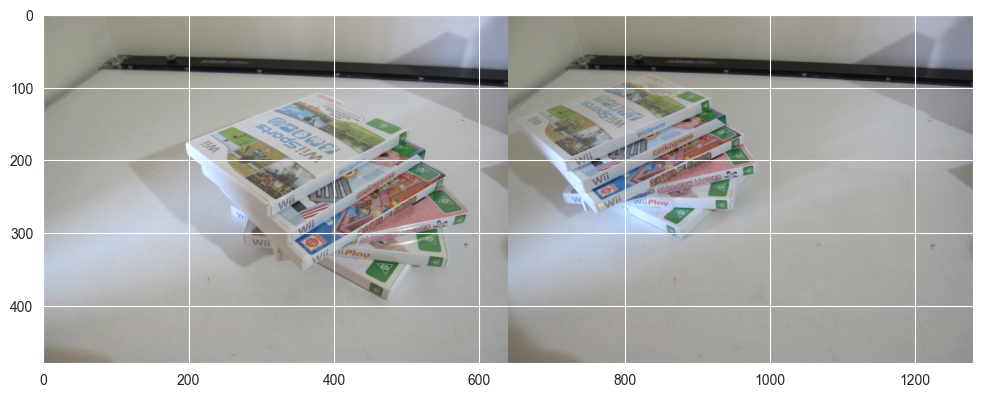

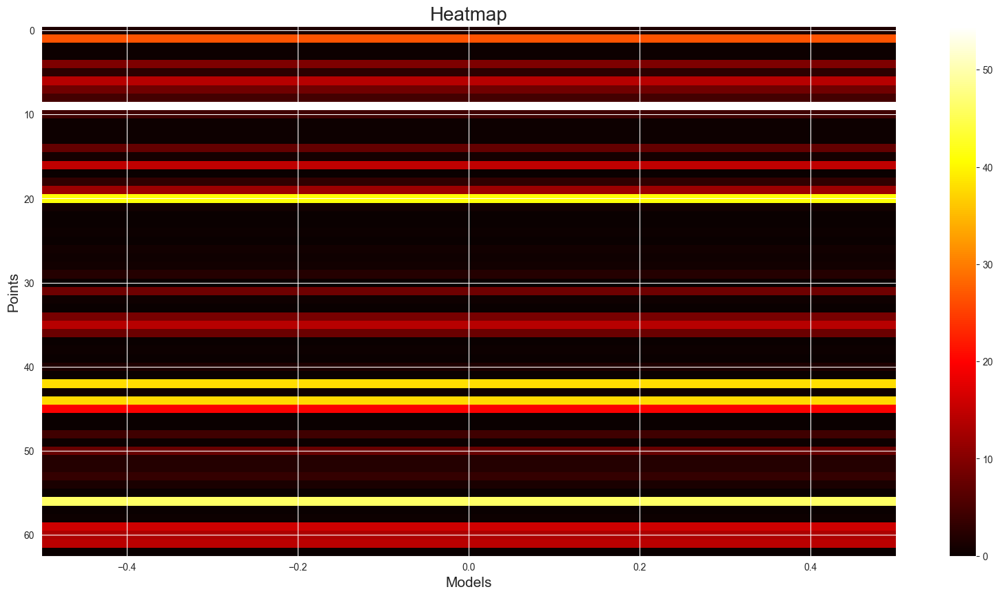

97.0 inliers found
the total number of point is:  97
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

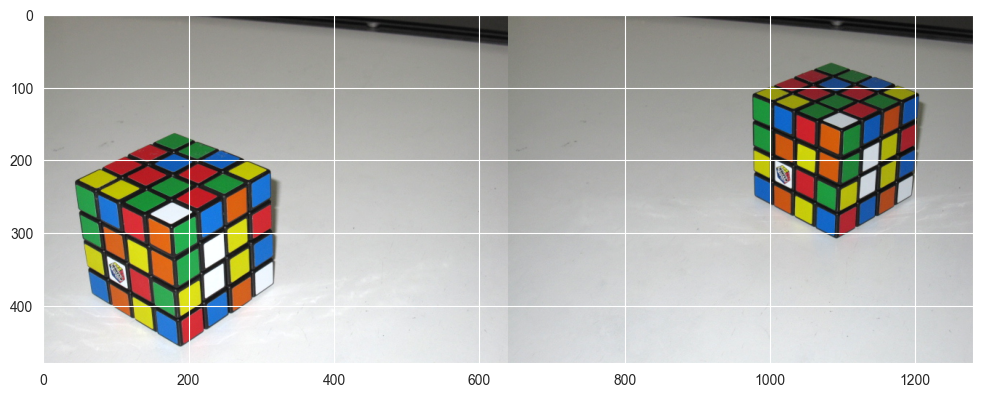

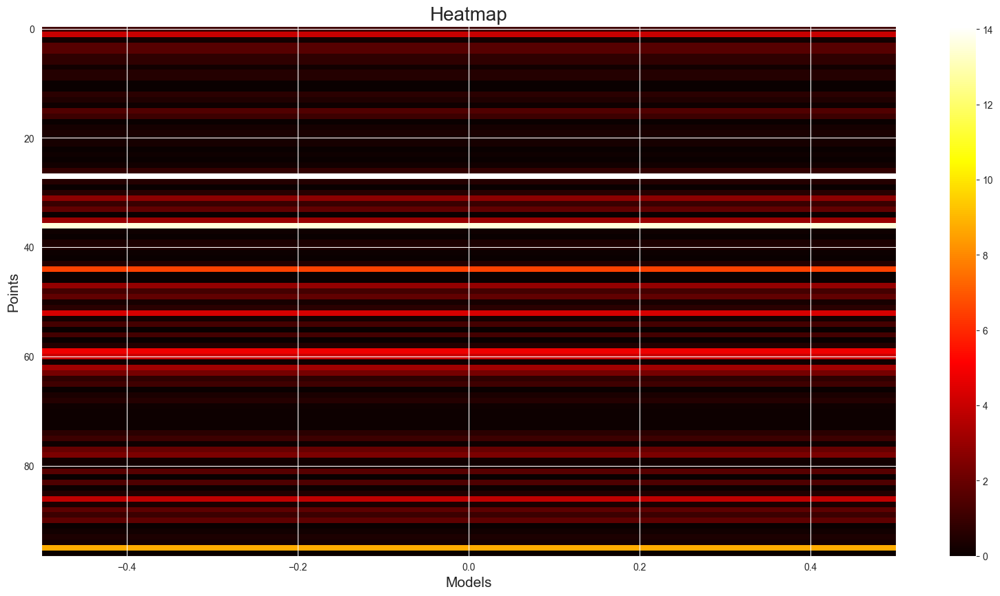

105.0 inliers found
the total number of point is:  105
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

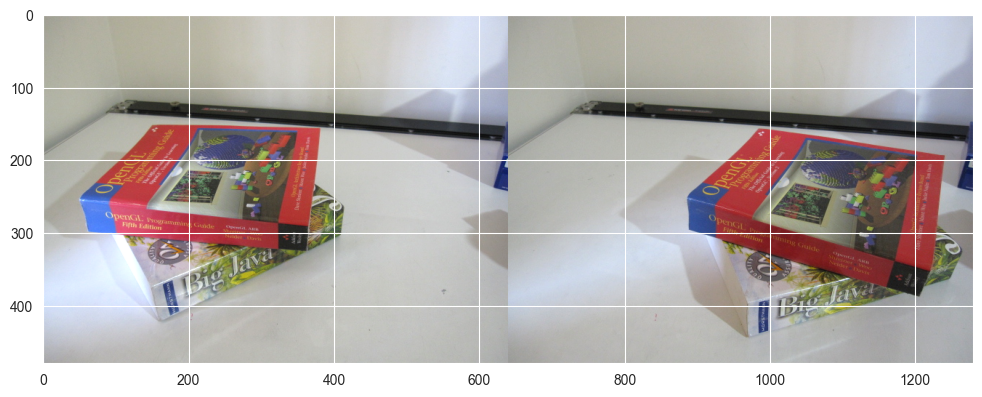

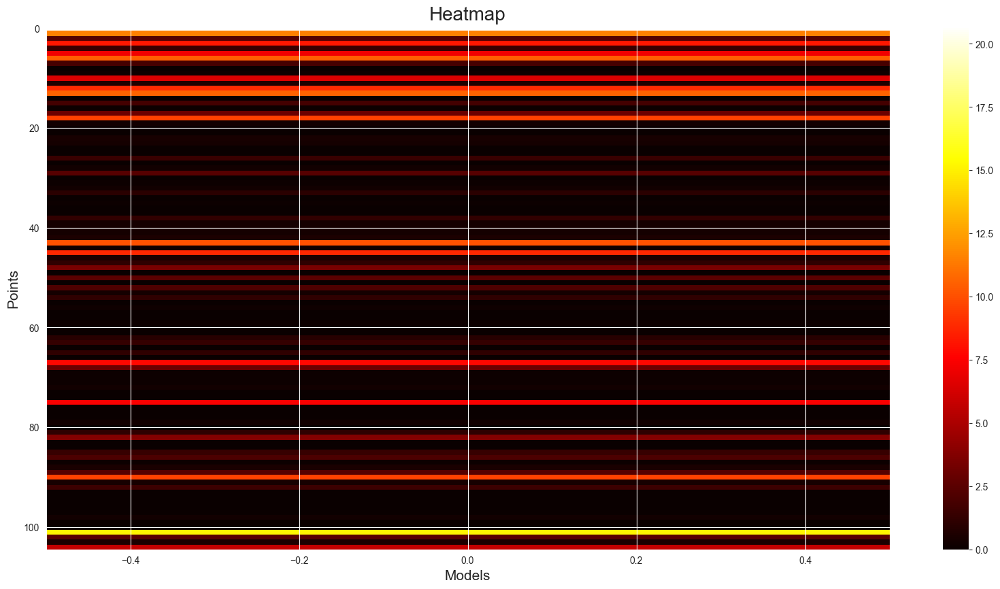

37.0 inliers found
the total number of point is:  37
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

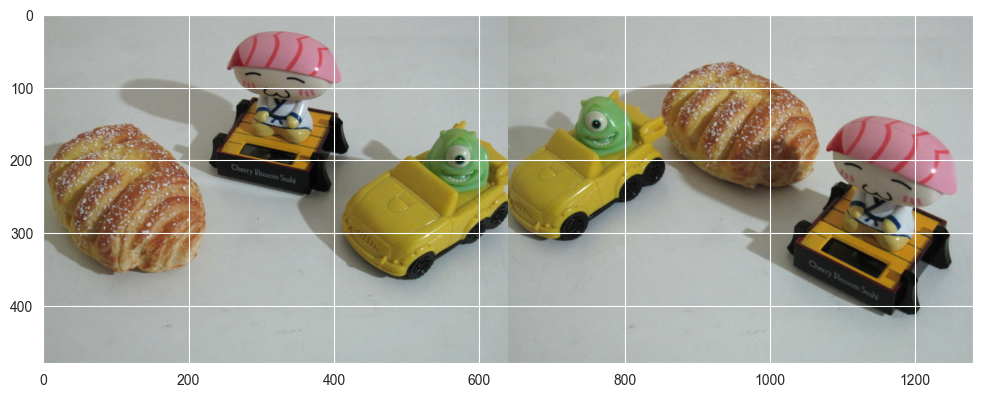

39.0 inliers found
the total number of point is:  39
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

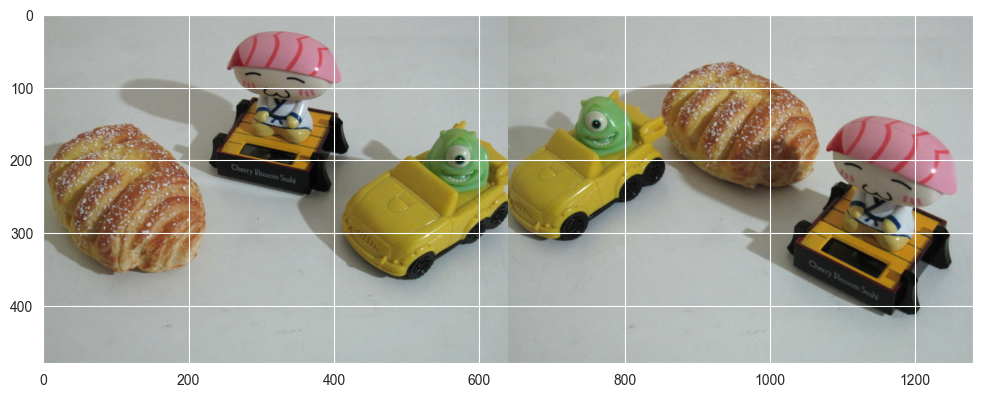

34.0 inliers found
the total number of point is:  34
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

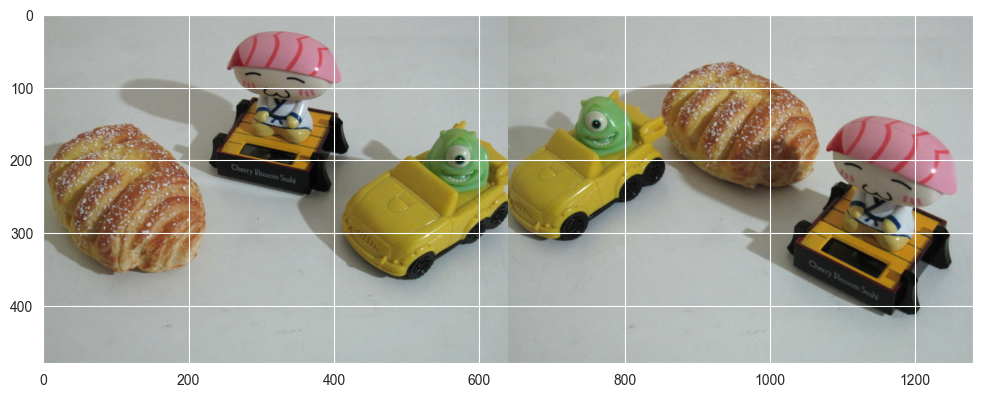

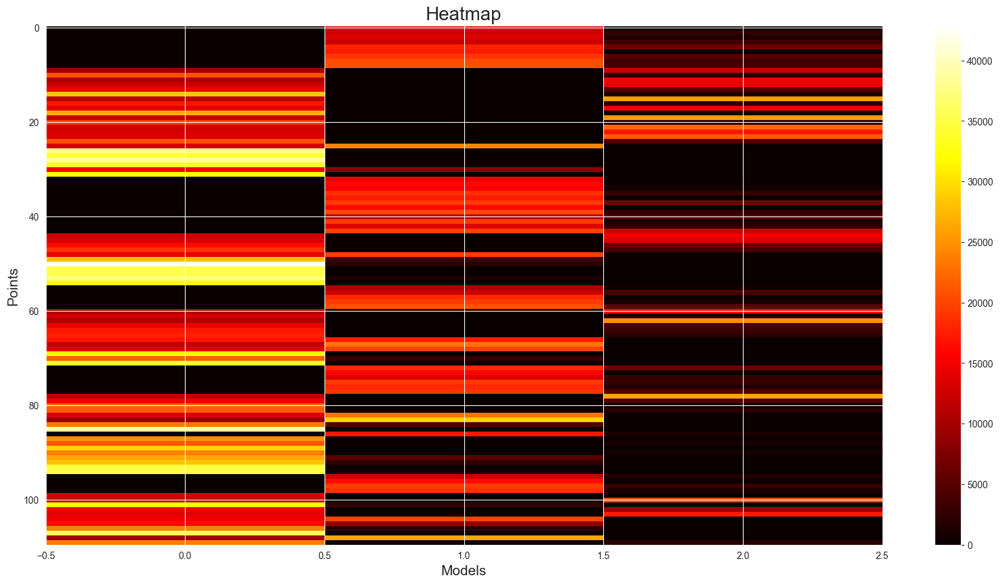

73.0 inliers found
the total number of point is:  73
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

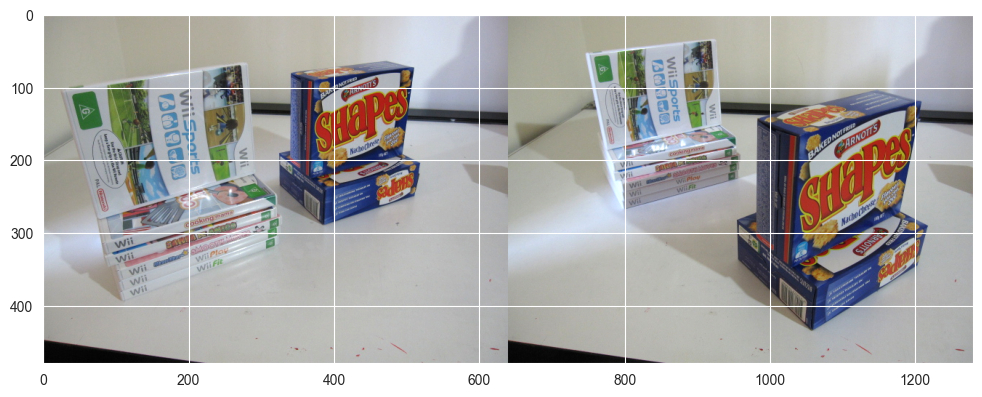

88.0 inliers found
the total number of point is:  88
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

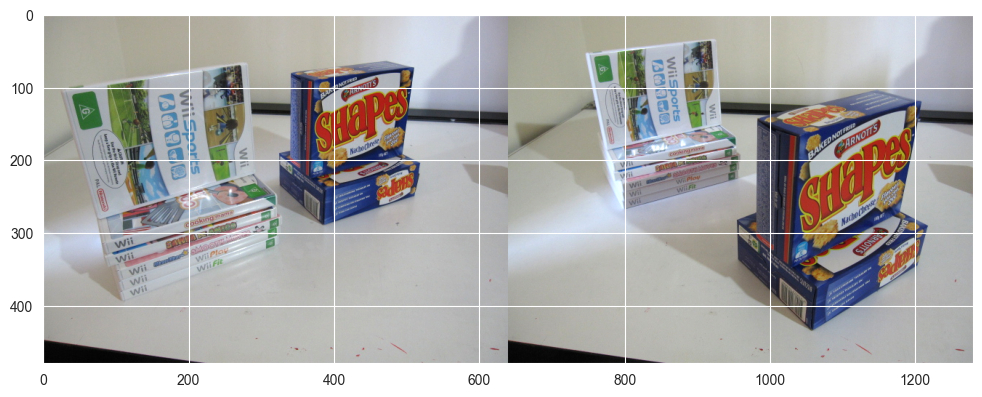

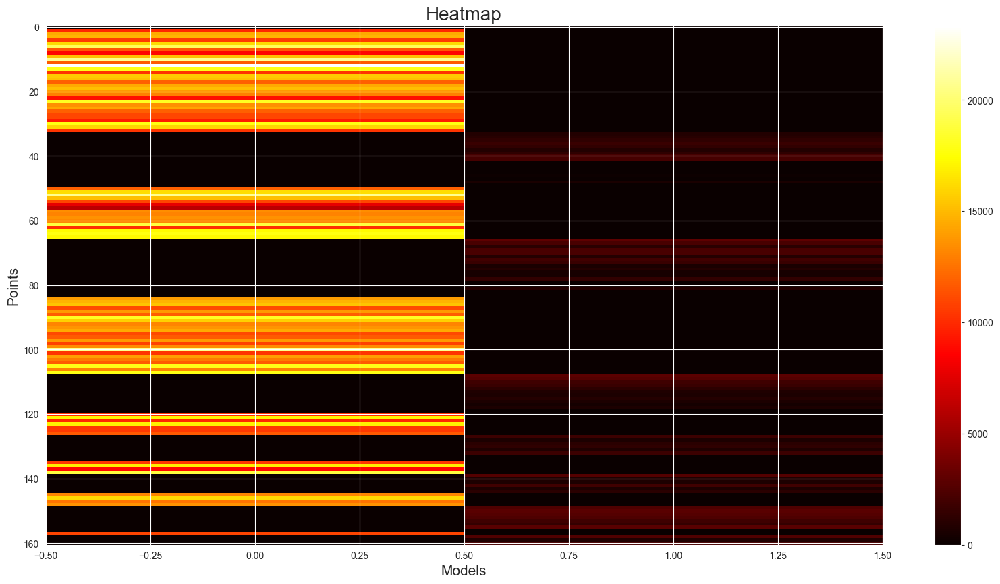

44.0 inliers found
the total number of point is:  45
The indexes of outlier points are: [96]


<Figure size 640x480 with 0 Axes>

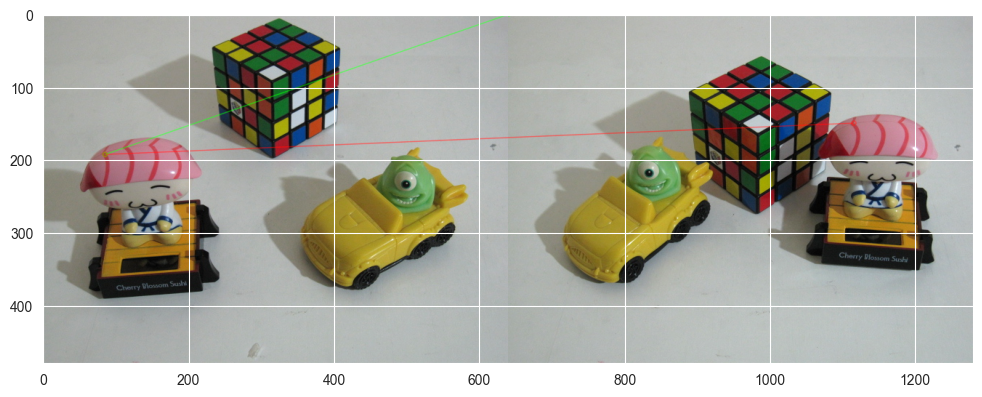

69.0 inliers found
the total number of point is:  69
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

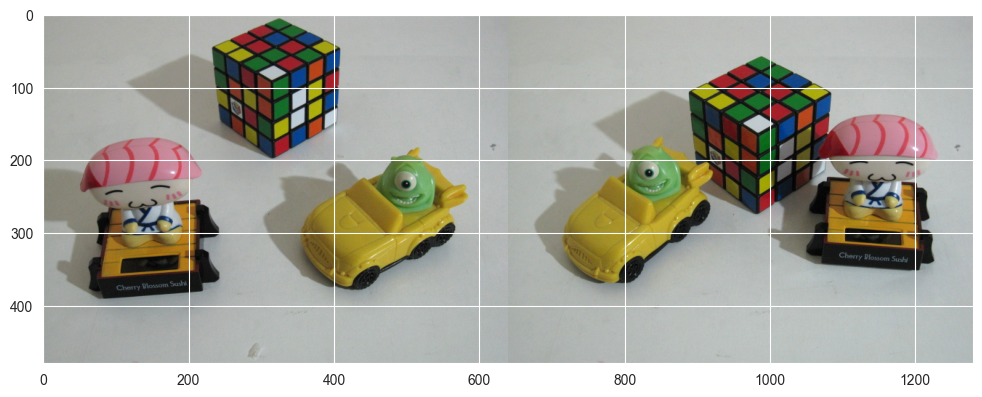

8.0 inliers found
the total number of point is:  14
The indexes of outlier points are: [24, 27, 59, 78, 79, 124]


<Figure size 640x480 with 0 Axes>

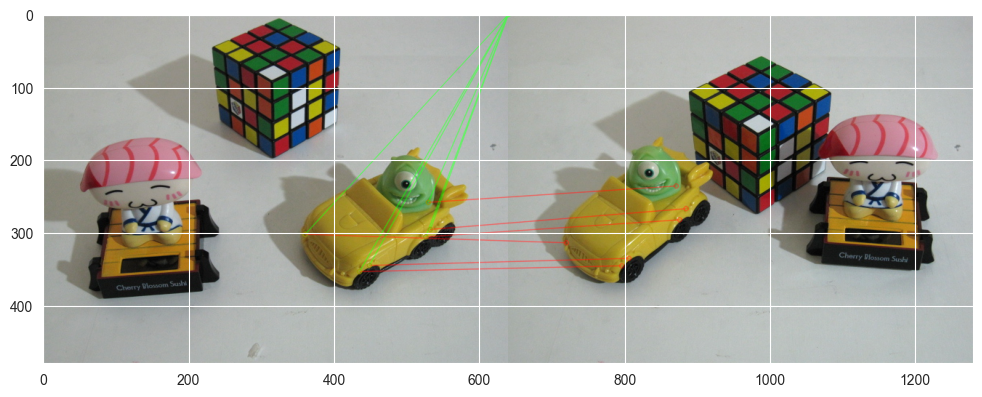

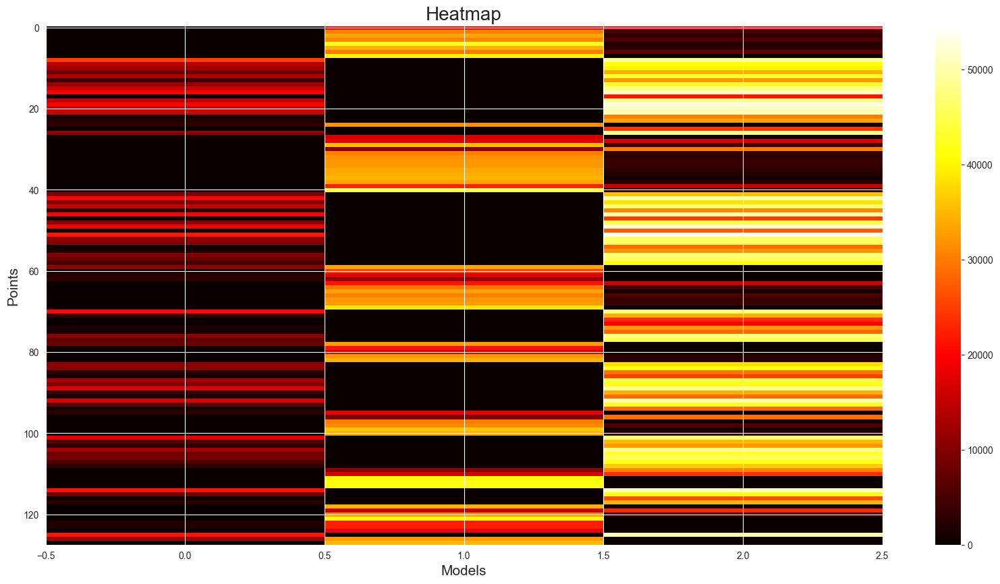

67.0 inliers found
the total number of point is:  67
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

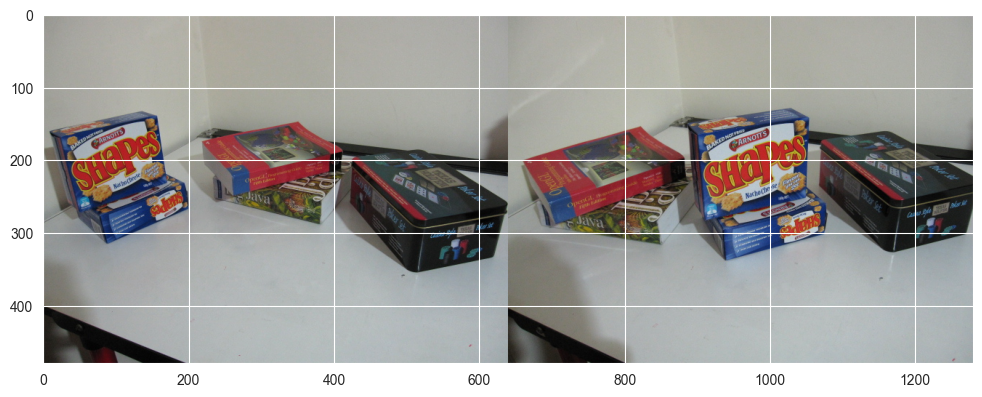

41.0 inliers found
the total number of point is:  41
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

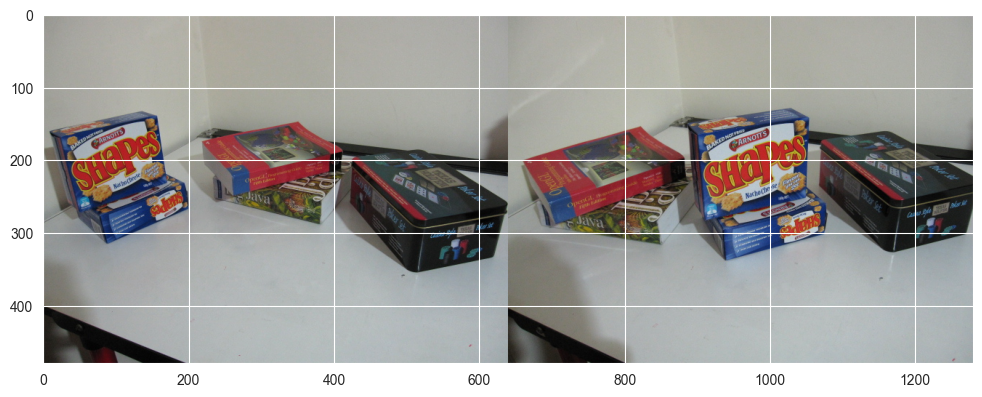

54.0 inliers found
the total number of point is:  54
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

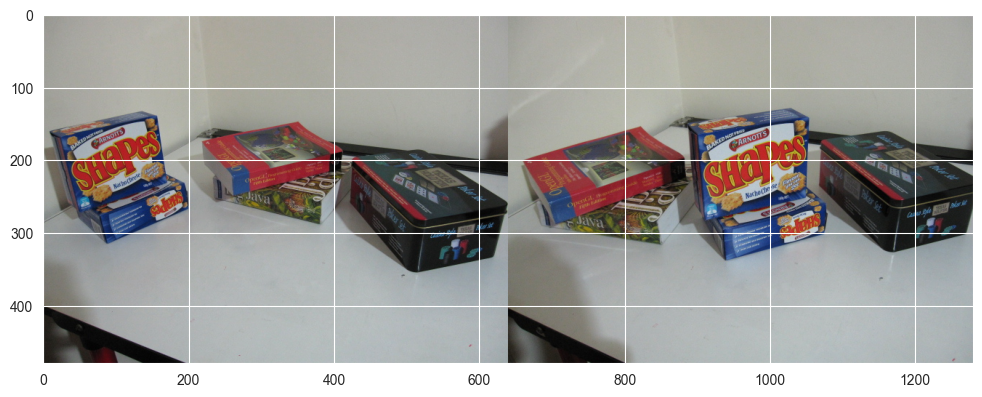

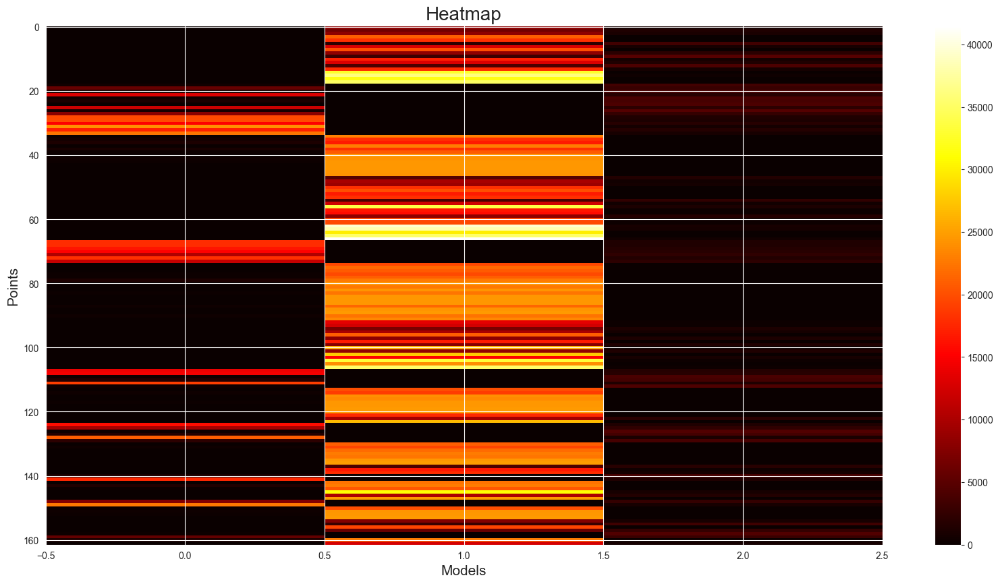

34.0 inliers found
the total number of point is:  34
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

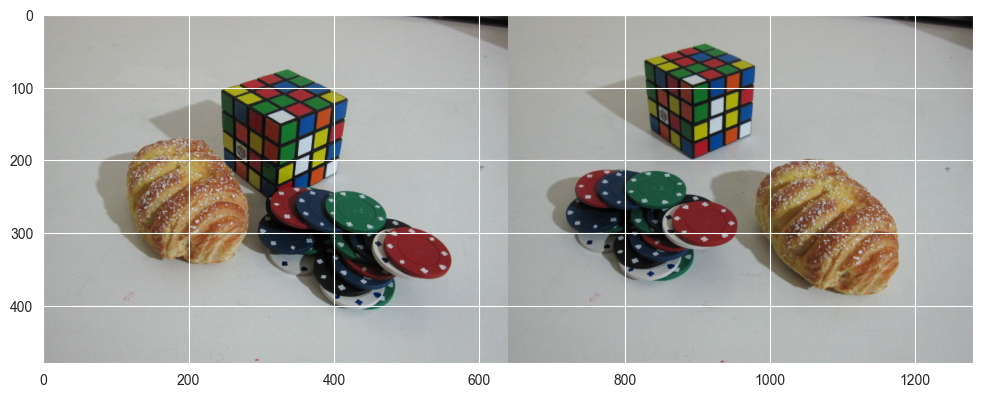

57.0 inliers found
the total number of point is:  57
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

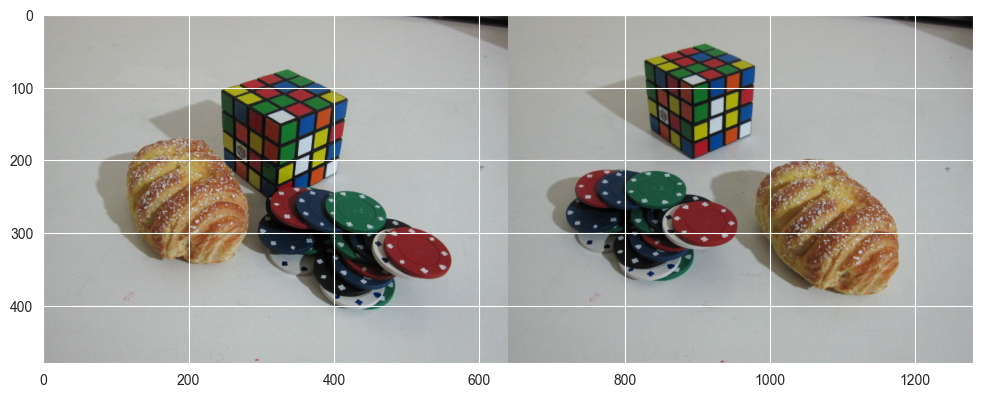

58.0 inliers found
the total number of point is:  58
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

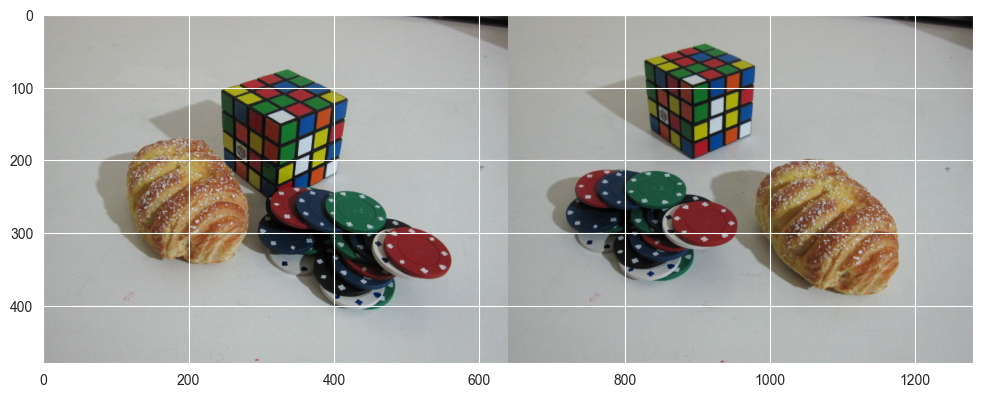

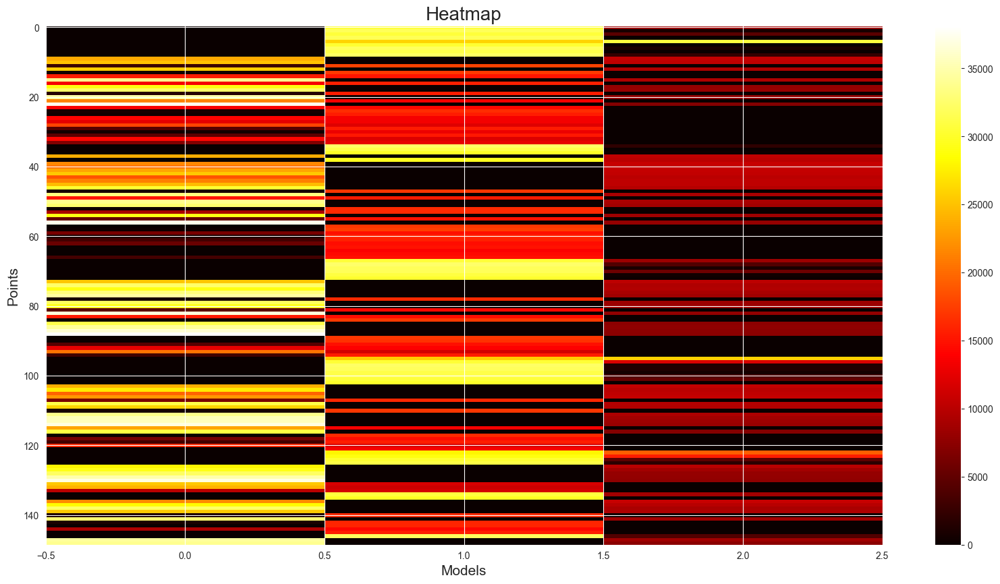

32.0 inliers found
the total number of point is:  33
The indexes of outlier points are: [74]


<Figure size 640x480 with 0 Axes>

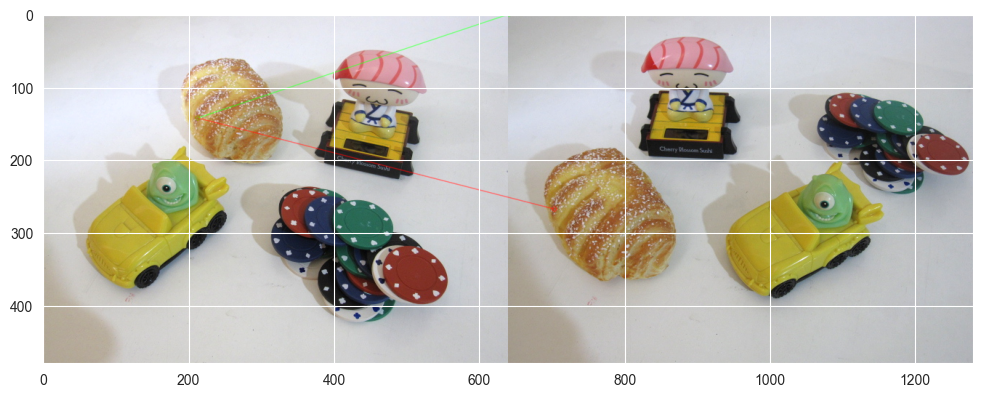

23.0 inliers found
the total number of point is:  23
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

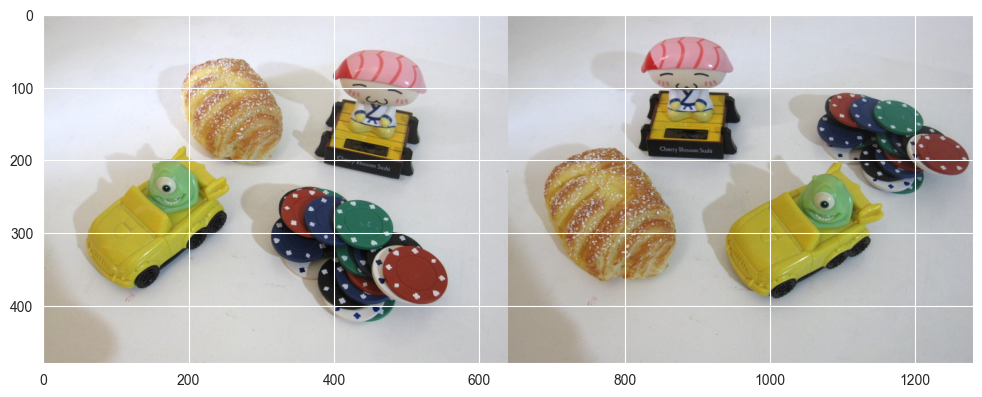

41.0 inliers found
the total number of point is:  41
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

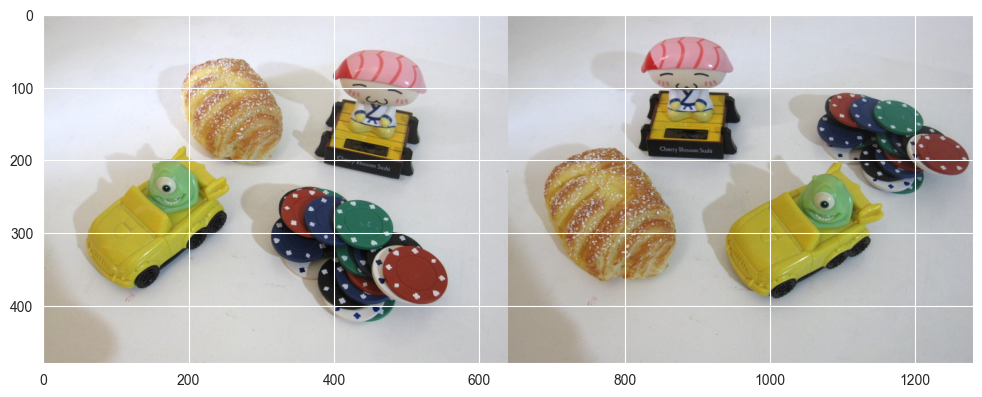

58.0 inliers found
the total number of point is:  58
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

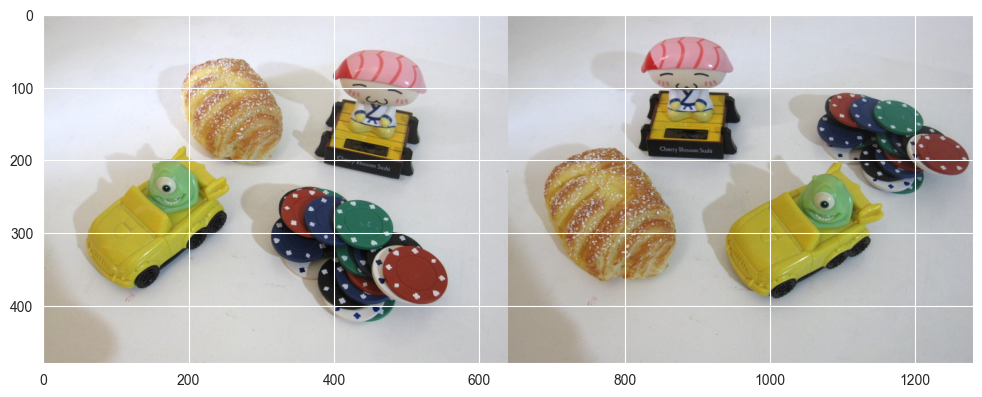

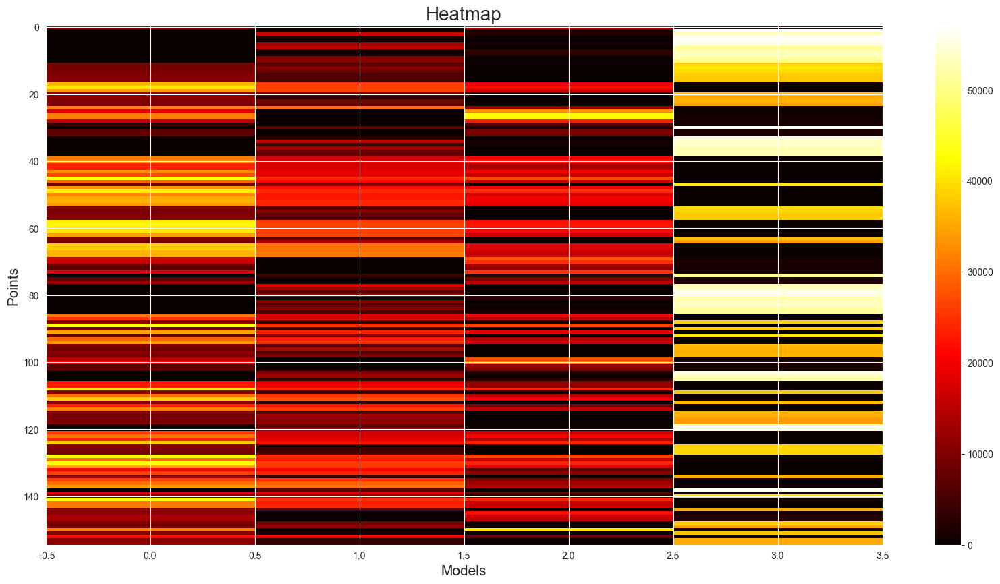

97.0 inliers found
the total number of point is:  97
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

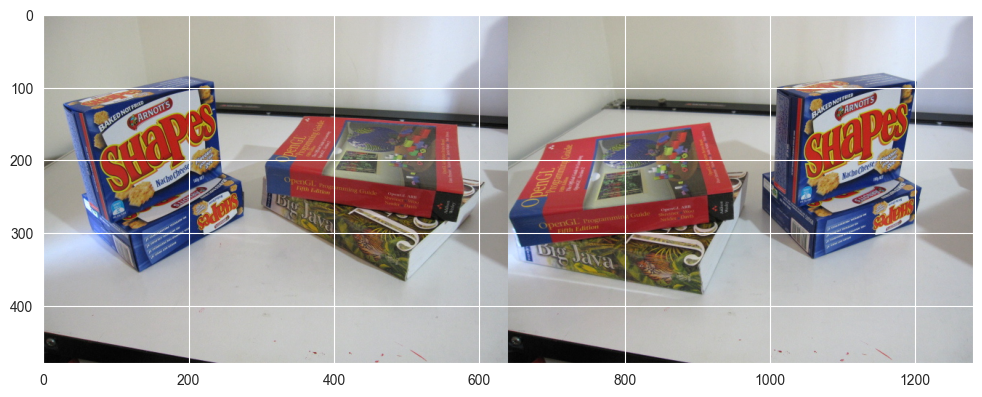

82.0 inliers found
the total number of point is:  82
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

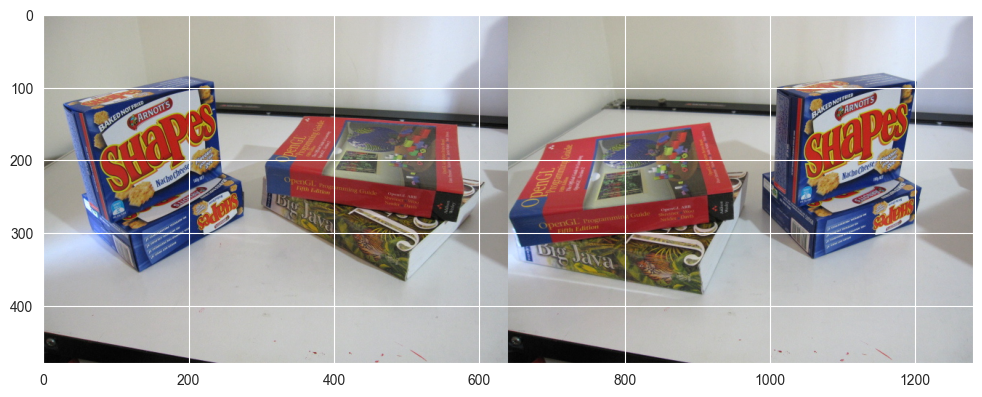

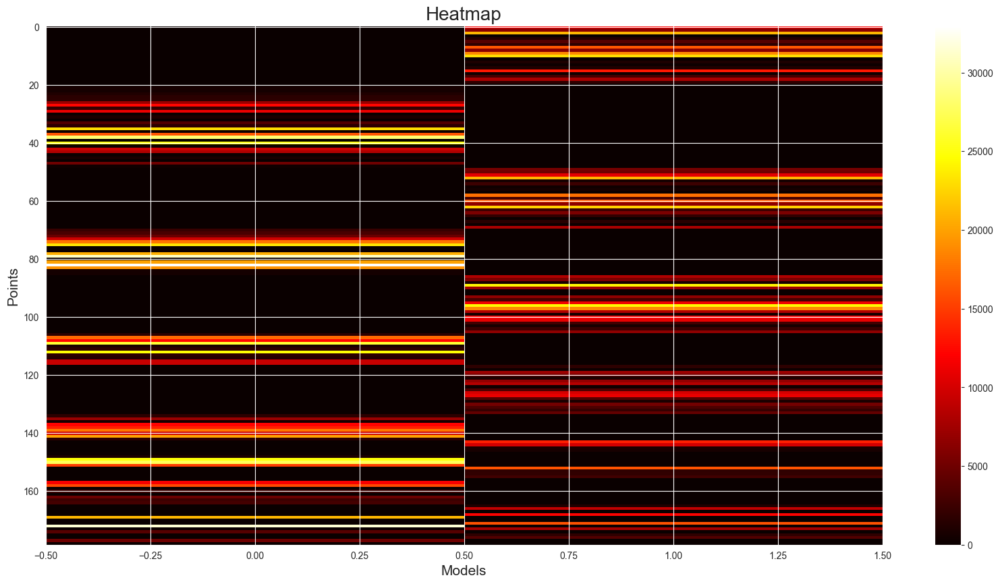

64.0 inliers found
the total number of point is:  69
The indexes of outlier points are: [43, 54, 55, 90, 132]


<Figure size 640x480 with 0 Axes>

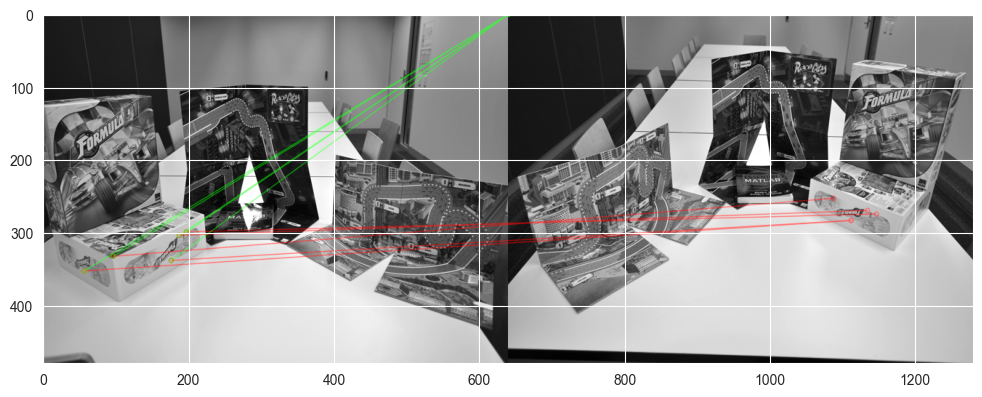

66.0 inliers found
the total number of point is:  68
The indexes of outlier points are: [16, 153]


<Figure size 640x480 with 0 Axes>

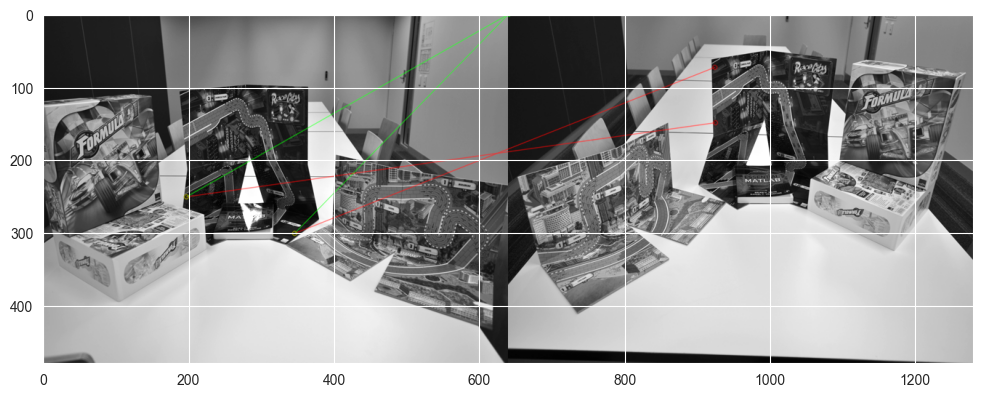

28.0 inliers found
the total number of point is:  29
The indexes of outlier points are: [85]


<Figure size 640x480 with 0 Axes>

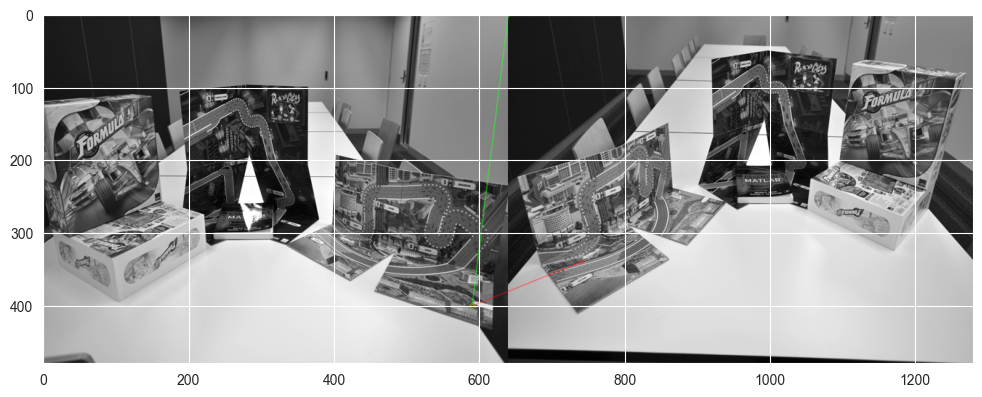

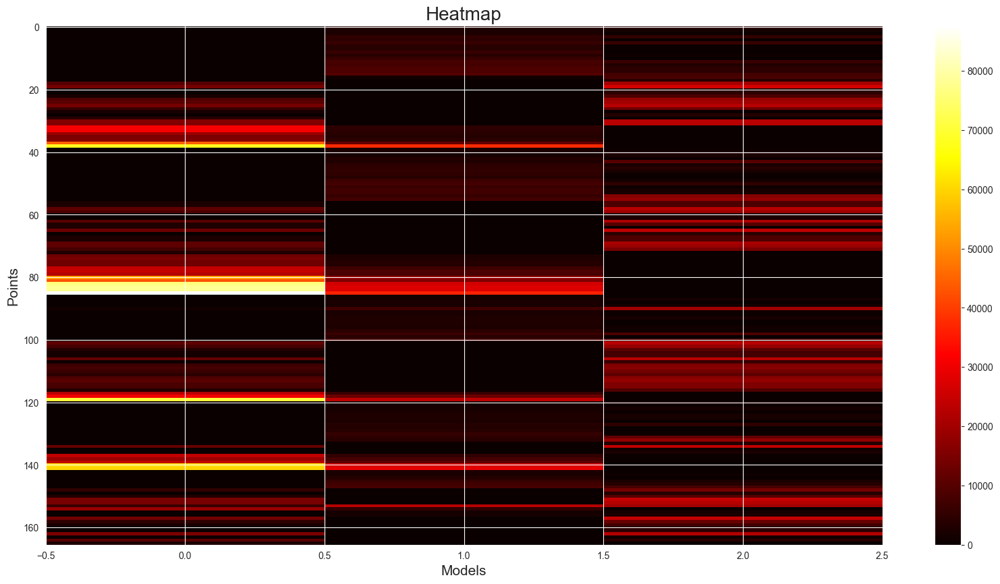

84.0 inliers found
the total number of point is:  84
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

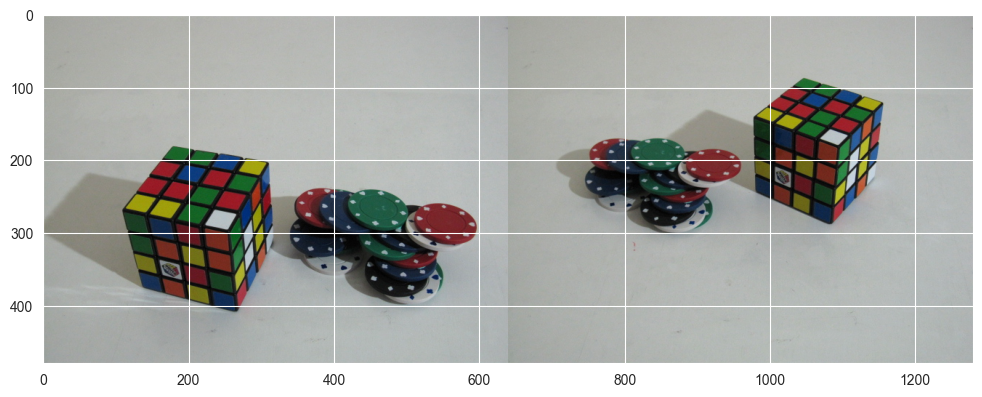

57.0 inliers found
the total number of point is:  57
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

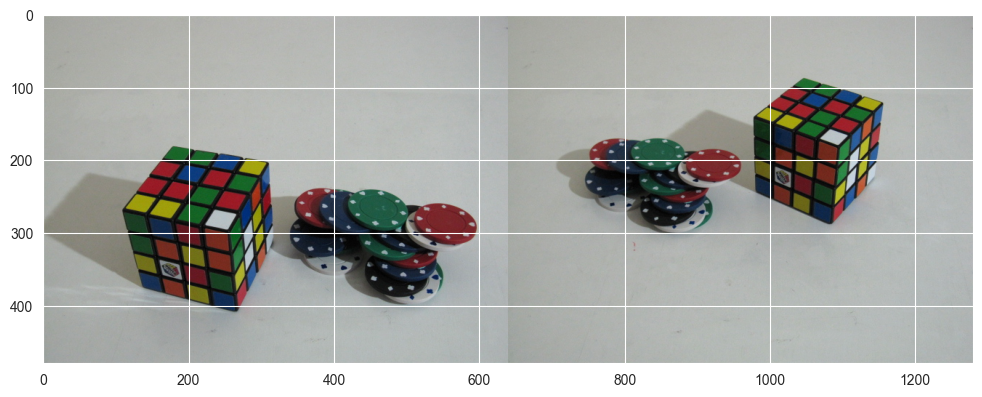

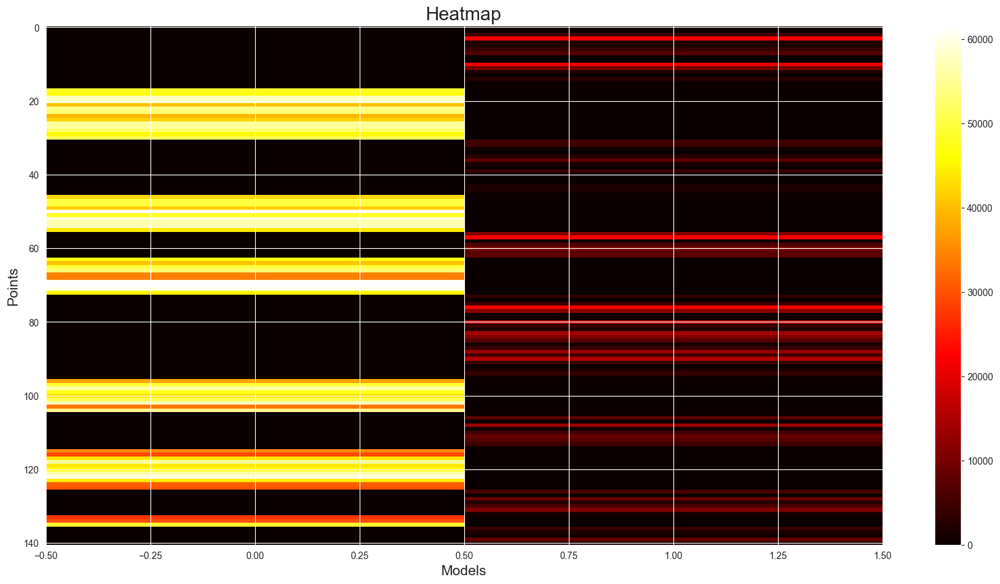

19.0 inliers found
the total number of point is:  19
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

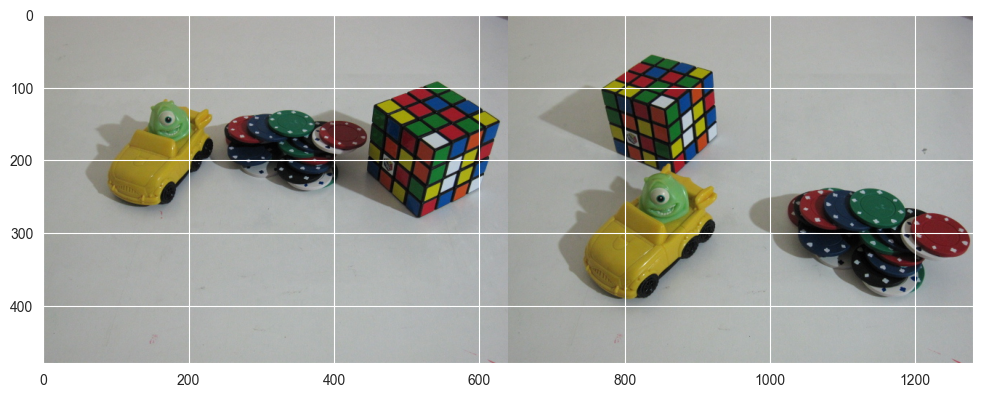

33.0 inliers found
the total number of point is:  33
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

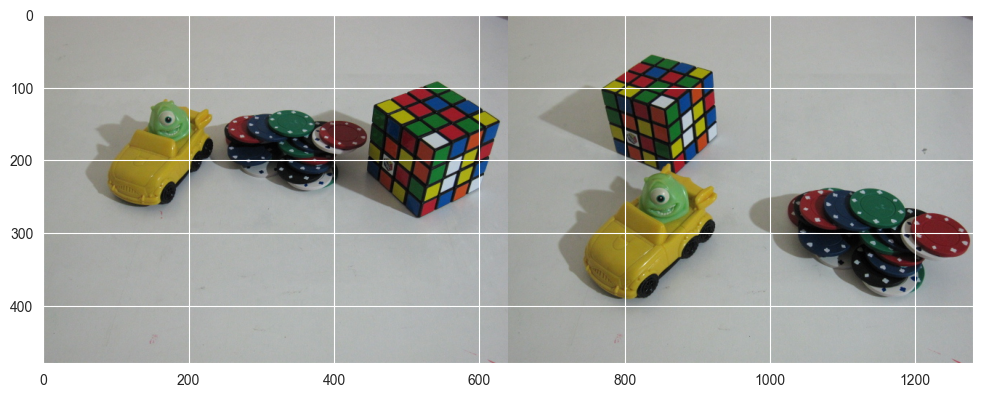

53.0 inliers found
the total number of point is:  53
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

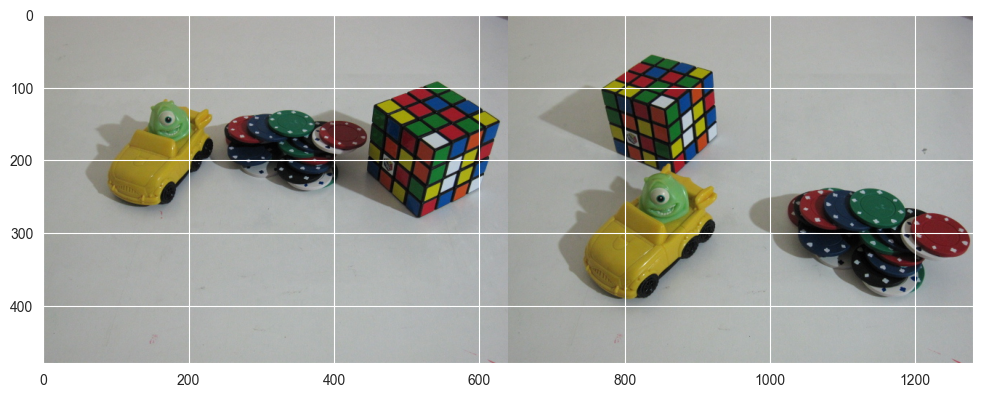

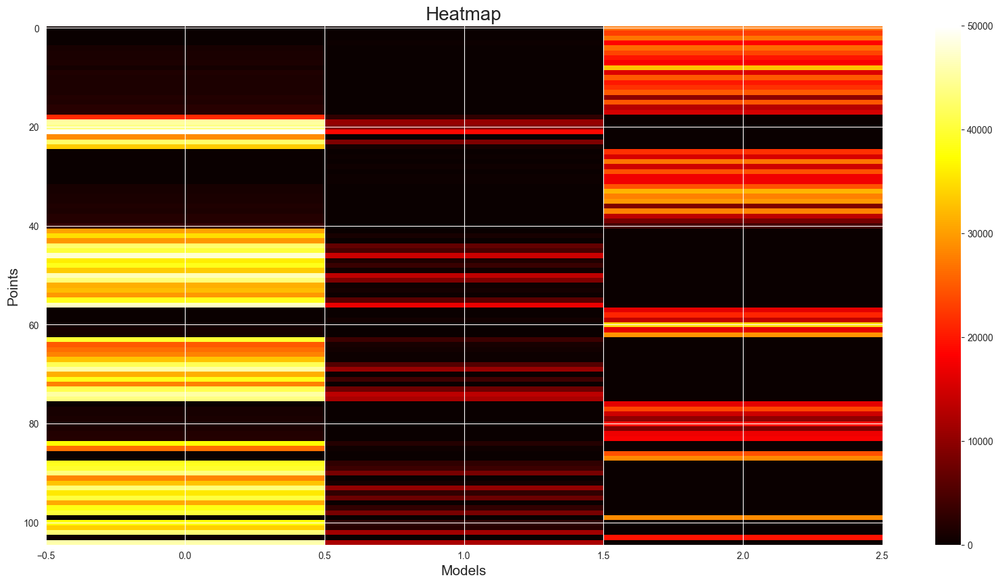

78.0 inliers found
the total number of point is:  78
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

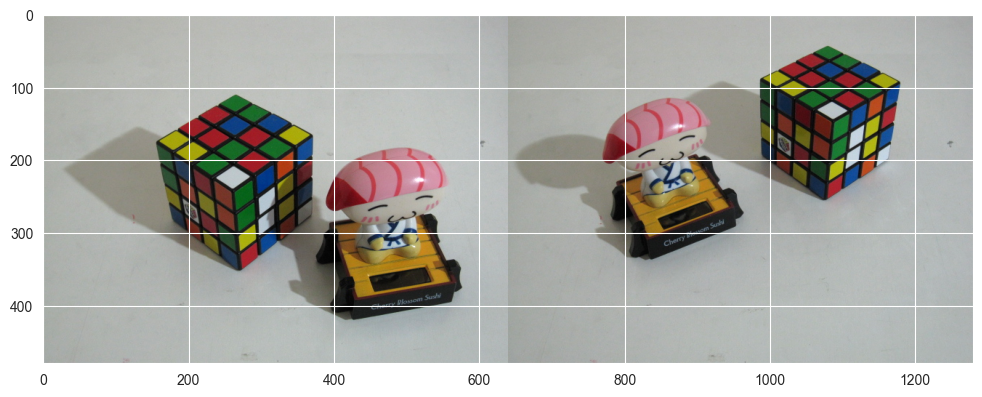

68.0 inliers found
the total number of point is:  72
The indexes of outlier points are: [47, 78, 79, 132]


<Figure size 640x480 with 0 Axes>

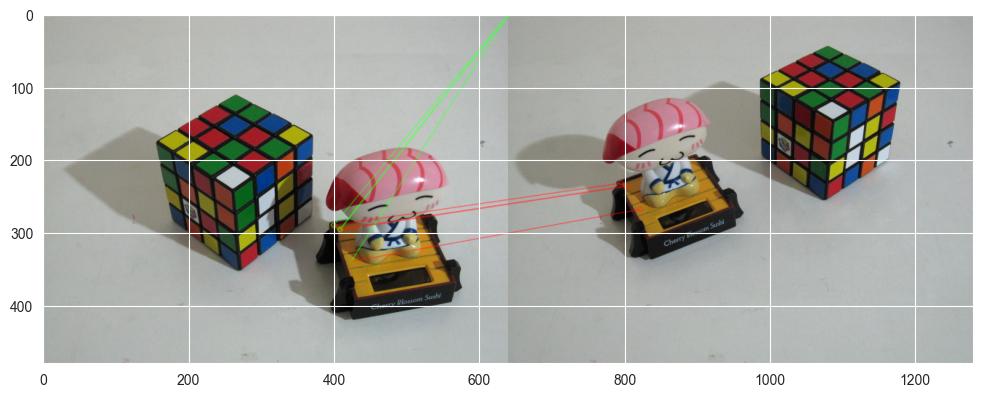

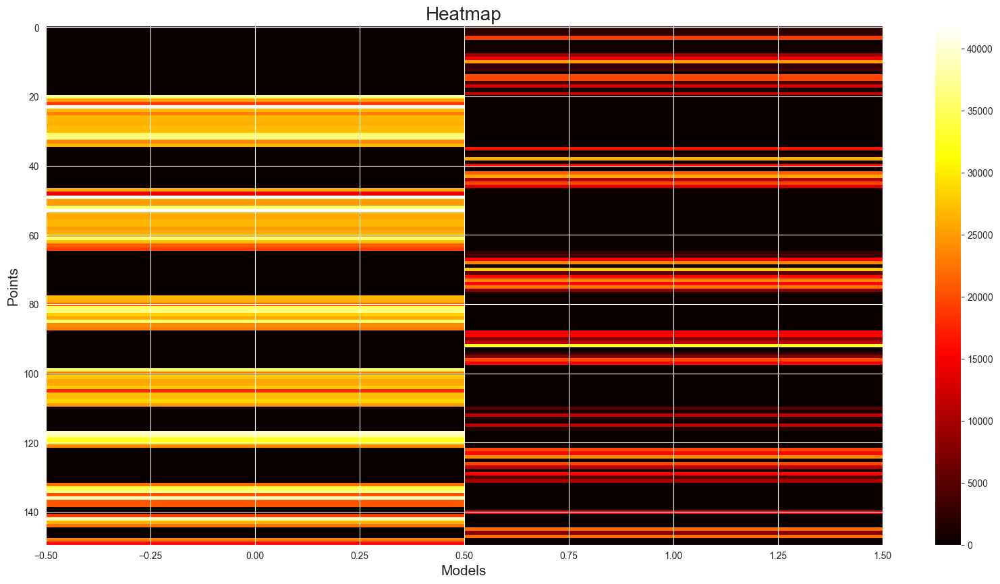

63.0 inliers found
the total number of point is:  63
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

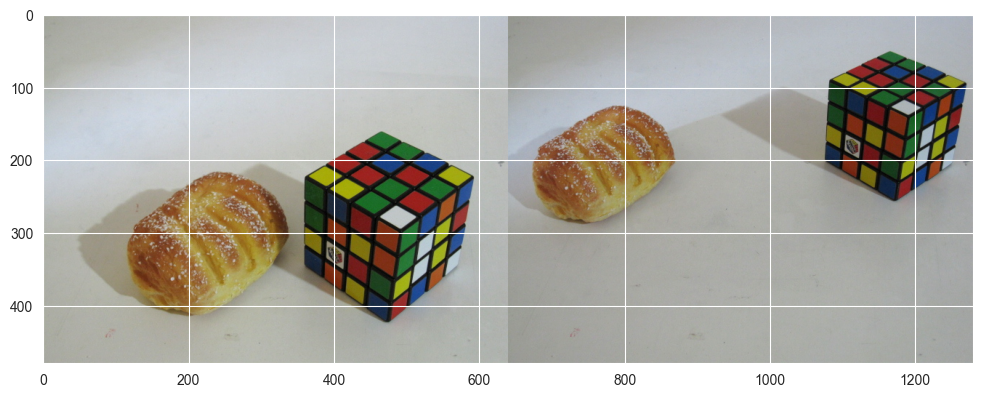

102.0 inliers found
the total number of point is:  102
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

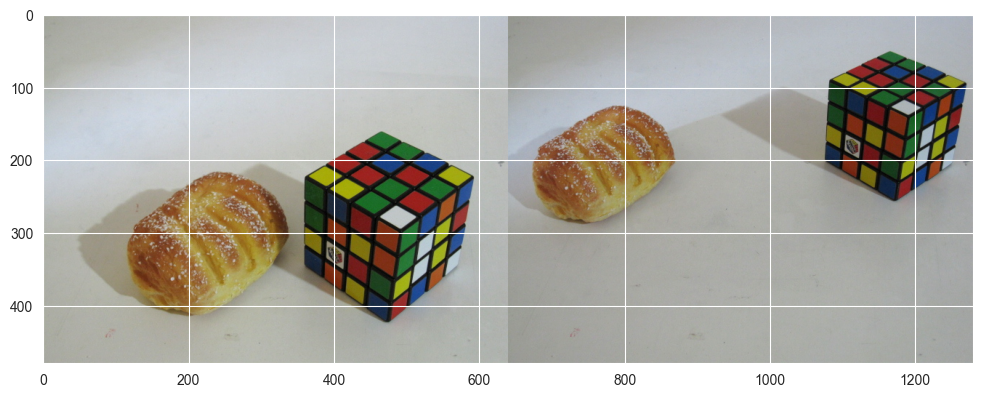

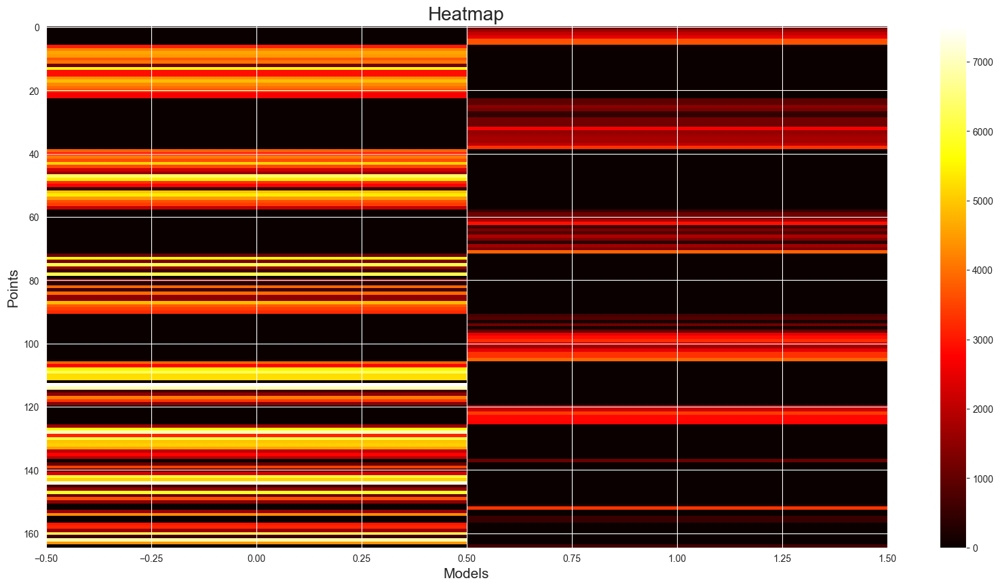

124.0 inliers found
the total number of point is:  124
The indexes of outlier points are: []


<Figure size 640x480 with 0 Axes>

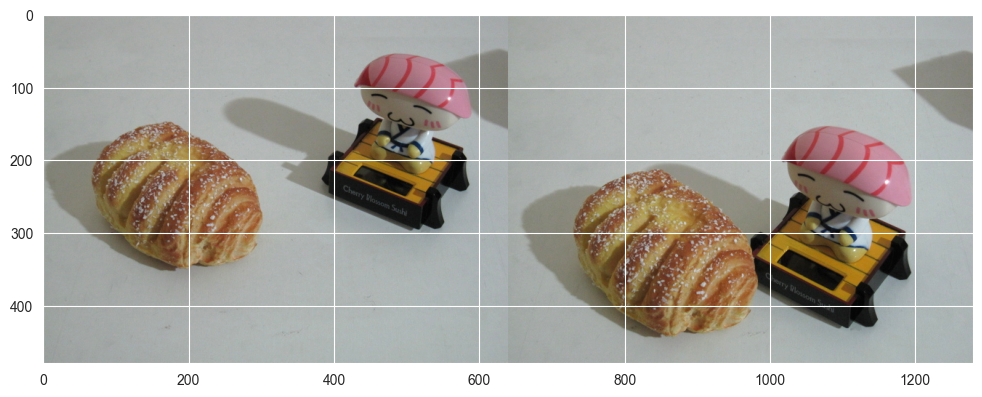

57.0 inliers found
the total number of point is:  58
The indexes of outlier points are: [97]


<Figure size 640x480 with 0 Axes>

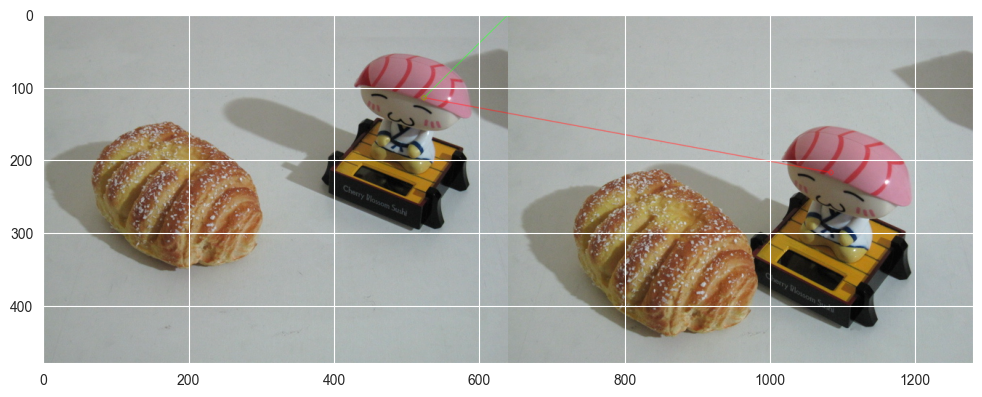

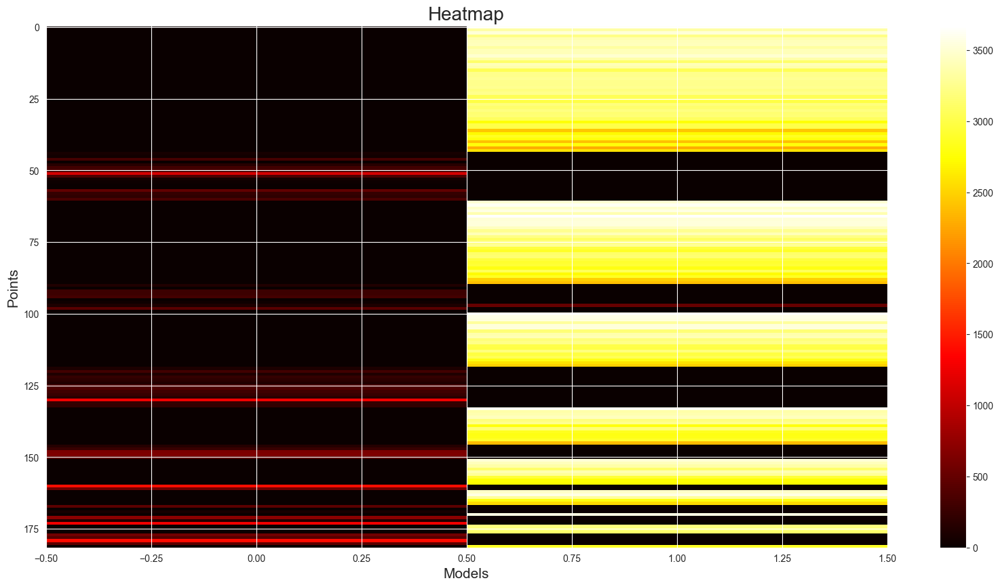

In [21]:
plot_heat=True

for i in range(len(names)):
    data=mat_data[names[i]]
    res, _, _=build_residual_matrix(data, plot=True, method='ransac', type='FM', threshold=thresholds[i])

    if plot_heat:
        plt.figure(figsize=(20, 10))  # Adjust figure size here
        plt.imshow(res, cmap='hot', interpolation='nearest', aspect="auto")
        #cbar = plt.colorbar()  # Add colorbar to show values
        plt.colorbar().ax.tick_params(labelsize=10)  # Adjust colorbar label size
        plt.title('Heatmap', fontsize=20)  # Adjust title font size
        plt.xlabel('Models', fontsize=15)  # Adjust x-axis label font size
        plt.ylabel('Points', fontsize=15)  # Adjust y-axis label font size
        plt.show()

In [ ]:
def verify_essential_matrix(src_, dst_, method=cv2.RANSAC, threshold=None, verbose=False):
        kps1, kps2, matches = build_keypts_matches(src_points, dst_points)
        src_pts = np.float32([kps1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kps2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
        E, mask = cv2.findEssentialMat(src_pts, dst_pts, method=method, threshold=threshold)
        inliers = deepcopy(mask).astype(np.float32).sum()
        if verbose: print(inliers, 'inliers found')
        return E, mask.ravel()

In [ ]:
rootFM = '/Users/gabrielegiusti/Desktop/Progetto_IACV/adelFM/'
print(os.listdir(rootFM))
data = [f for f in os.listdir(rootFM) if os.path.isfile(rootFM + f)]
data1 = spi.loadmat(rootFM + data[0])
data2 = spi.loadmat(rootFM + data[3])
keypts = data1['data']

In [ ]:
img1,img2=data1["img1"],data1["img2"]

outliers,models=vi.group_models(data1)["outliers"],vi.group_models(data1)["models"]

src_points = np.array(list(zip(models[0][0], models[0][1])))

dst_points = np.array(list(zip(models[0][2], models[0][3])))

In [ ]:
t=time()
cv2_E, cv2_mask = verify_essential_matrix(src_points, dst_points, threshold=thresholds[0][0])
print (time()-t, ' sec cv2')

# t=time()
# gc_H, gc_mask = verify_pygcransac_H(src_points , dst_points , img1 , img2 , 2 , 10 , 20)
# print ((time()-t), ' sec gc-ransac')
#
#
#
# # Compute the element-wise difference
# difference_mask = gc_mask != cv2_mask
# difference_mask=difference_mask.astype(np.uint8)
# print("the difference between ransac and gc_ransac: ",len(difference_mask))

print("the total number of point is: ",len(src_points))

In [ ]:
R1, R2, t = cv2.decomposeEssentialMat(cv2_E)

R1, R2, t

In [ ]:
P = 